In [ ]:
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.applications import resnet50
from tensorflow.keras.datasets import mnist, cifar10, cifar100
from tensorflow.keras.utils import to_categorical, plot_model
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Dropout, Flatten, Dense, Input, Activation, BatchNormalization, UpSampling2D, Reshape
from tensorflow.keras.optimizers import Adam, SGD
from sklearn.metrics import mean_squared_error
import time

In [ ]:
NUM_CLASSES = 100
WIDTH = 32
NUM_CHANNELS = 3
NUM_TRAIN = 50000
NUM_TEST = 10000
NUM_DEV = 100

DATASET = "cifar100"
BASE_DIR = f""

### Label dictionary

In [ ]:
str_labels = ['apple', 'aquarium_fish', 'baby', 'bear', 'beaver', 'bed', 'bee', 'beetle', 'bicycle', 'bottle', 'bowl', 'boy', 'bridge', 'bus', 'butterfly', 'camel', 'can', 'castle', 'caterpillar', 'cattle', 'chair', 'chimpanzee', 'clock', 'cloud', 'cockroach', 'couch', 'crab', 'crocodile', 'cup', 'dinosaur', 'dolphin', 'elephant', 'flatfish', 'forest', 'fox', 'girl', 'hamster', 'house', 'kangaroo', 'keyboard', 'lamp', 'lawn_mower', 'leopard', 'lion', 'lizard', 'lobster', 'man', 'maple_tree', 'motorcycle', 'mountain', 'mouse', 'mushroom', 'oak_tree', 'orange', 'orchid', 'otter', 'palm_tree', 'pear', 'pickup_truck', 'pine_tree', 'plain', 'plate', 'poppy', 'porcupine', 'possum', 'rabbit', 'raccoon', 'ray', 'road', 'rocket', 'rose', 'sea', 'seal', 'shark', 'shrew', 'skunk', 'skyscraper', 'snail', 'snake', 'spider', 'squirrel', 'streetcar', 'sunflower', 'sweet_pepper', 'table', 'tank', 'telephone', 'television', 'tiger', 'tractor', 'train', 'trout', 'tulip', 'turtle', 'wardrobe', 'whale', 'willow_tree', 'wolf', 'woman', 'worm']
label_dict = {i: str_labels[i] for i in range(len(str_labels))}

## Utils

In [ ]:
# load train and test dataset (cifar100)
def load_dataset():
	# load dataset
	(trainX, trainY), (testX, testY) = cifar100.load_data()
	trainX = trainX.reshape((trainX.shape[0], 32, 32, 3))
	testX = testX.reshape((testX.shape[0], 32, 32, 3))
	# one hot encode target values
	trainY = to_categorical(trainY)
	testY = to_categorical(testY)
	return trainX, trainY, testX, testY

# scale pixels
def prep_pixels(train, test):
	# convert from integers to floats
	train_norm = train.astype('float32')
	test_norm = test.astype('float32')
	# normalize to range 0-1
	train_norm = train_norm / 255.0
	test_norm = test_norm / 255.0
	# return normalized images
	return train_norm, test_norm

# predictive model
def cnn_cifar(inp_shape=(32,32,3), n_classes=100):
	model = tf.keras.Sequential()
	model.add(tf.keras.layers.Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_uniform', padding='same', input_shape=inp_shape, dtype=np.float64))
	model.add(tf.keras.layers.Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_uniform', padding='same', dtype=np.float64))
	model.add(tf.keras.layers.MaxPooling2D((2, 2), dtype=np.float64))
	model.add(tf.keras.layers.Dropout(0.2, dtype=np.float64))
	model.add(tf.keras.layers.Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_uniform', padding='same', dtype=np.float64))
	model.add(tf.keras.layers.Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_uniform', padding='same', dtype=np.float64))
	model.add(tf.keras.layers.MaxPooling2D((2, 2), dtype=np.float64))
	model.add(tf.keras.layers.Dropout(0.2, dtype=np.float64))
	model.add(tf.keras.layers.Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_uniform', padding='same', dtype=np.float64))
	model.add(tf.keras.layers.Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_uniform', padding='same', dtype=np.float64))
	model.add(tf.keras.layers.MaxPooling2D((2, 2), dtype=np.float64))
	model.add(tf.keras.layers.Dropout(0.2, dtype=np.float64))
	model.add(tf.keras.layers.Flatten(dtype=np.float64))
	model.add(tf.keras.layers.Dense(128, activation='relu', kernel_initializer='he_uniform', name='penultimate', dtype=np.float64))
	model.add(tf.keras.layers.Dropout(0.2, dtype=np.float64))
	# model.add(tf.keras.layers.Dense(n_classes, activation='softmax', dtype=np.float64))
	model.add(tf.keras.layers.Dense(n_classes, name='presoft', dtype=np.float64))
	model.add(tf.keras.layers.Softmax(dtype=np.float64))  # for resmem where want to operate on pre-softmax output

	# compile model
	model.compile(optimizer='Adam', loss='categorical_crossentropy', metrics=['accuracy'])
	return model


def resnet50_cifar(inp_shape=(32,32,3), n_classes=100, use_imagenet=True, opt='Adam'):
  if use_imagenet:
    resnet_model = resnet50.ResNet50(input_shape=(224,224,3), include_top=False, weights='imagenet')
  else:
    resnet_model = resnet50.ResNet50(input_shape=inp_shape, include_top=False, weights=None)

  for layer in resnet_model.layers:
	  if isinstance(layer, BatchNormalization):
		  layer.trainable = True
	  else:
		  layer.trainable = False

  model = tf.keras.Sequential()
  if use_imagenet:
    model.add(UpSampling2D(size=(7, 7),interpolation='bilinear'))
  model.add(resnet_model)
  model.add(tf.keras.layers.GlobalAveragePooling2D())
  model.add(tf.keras.layers.Dropout(.25))
  model.add(tf.keras.layers.Dense(256, activation='relu'))
  model.add(tf.keras.layers.BatchNormalization())
  model.add(tf.keras.layers.Dense(n_classes, activation='softmax'))

  # compile model
  model.compile(optimizer=opt, loss='categorical_crossentropy', metrics=['accuracy'])
  return model

# set highest (probability) value in vector to 1, and all others to 0
def set_max_to_one(a):
    idx = a.argmax(axis=1)
    return (idx[:,None] == np.arange(a.shape[1])).astype(float)

# accuracy computation with one-hot encoded multi-class label vectors
def acc_ohe(Y, Y_pred):
    n = Y.shape[0]
    ohe_dim = Y.shape[1]
    return ((Y == Y_pred).sum(axis=1) == ohe_dim).sum() / n

## Data and Model Loading

In [ ]:
X_train, Y_train, X_test, Y_test = load_dataset()
X_train, X_test = prep_pixels(X_train, X_test)

169001437/169001437 [==============================] - 10s 0us/step


### Saved Model

In [ ]:
model = keras.models.load_model(f"{BASE_DIR}/resnet50_cifar100_latest.h5")

In [ ]:
# # train more
# train_datagen = tf.keras.preprocessing.image.ImageDataGenerator(
#         rotation_range = 10,
#         zoom_range = 0.1,
#         width_shift_range = 0.1,
#         height_shift_range = 0.1,
#         shear_range = 0.1,
#         horizontal_flip = True,
#         vertical_flip = False
#         )
# train_datagen.fit(X_train)

# model.fit(
#     train_datagen.flow(X_train, Y_train, batch_size = 128),
#     validation_data = (X_test, Y_test),
#     epochs=2,
#     verbose=1
# )

In [ ]:
Y_pred_tr_m = model.predict(X_train)
Y_pred_te_m = model.predict(X_test)

print('Acc (Train):', (set_max_to_one(Y_pred_tr_m).argmax(axis=1) == Y_train.argmax(axis=1)).mean())
print('Acc (Test):', (set_max_to_one(Y_pred_te_m).argmax(axis=1) == Y_test.argmax(axis=1)).mean())

313/313 [==============================] - 29s 91ms/step
Acc (Train): 0.76654
Acc (Test): 0.7138


### Train Model

In [ ]:
train_datagen = tf.keras.preprocessing.image.ImageDataGenerator(
        rotation_range = 10,
        zoom_range = 0.1,
        width_shift_range = 0.1,
        height_shift_range = 0.1,
        shear_range = 0.1,
        horizontal_flip = True,
        vertical_flip = False
        )
train_datagen.fit(X_train)

In [ ]:
learning_rate_reduction = keras.callbacks.ReduceLROnPlateau(
    monitor='val_accuracy',
    patience=3,
    verbose=1,
    factor=0.6,
    min_lr=1e-6)

from tensorflow.keras.applications.resnet50 import ResNet50
resnet_model = ResNet50(
    include_top = False,
    weights = 'imagenet',
    input_shape = (224,224,3)
)

for layer in resnet_model.layers:
    if isinstance(layer, BatchNormalization):
        layer.trainable = True
    else:
        layer.trainable = False

model=tf.keras.models.Sequential()
model.add(UpSampling2D(size=(7, 7),interpolation='bilinear'))
model.add(resnet_model)
model.add(tf.keras.layers.GlobalAveragePooling2D())
model.add(Dropout(.25))
model.add(Dense(256, activation='relu'))
model.add(BatchNormalization())
model.add(Dense(100, activation='softmax'))

model.compile(
    optimizer = tf.keras.optimizers.SGD(learning_rate=1e-3, momentum=0.9),
    # optimizer = tf.keras.optimizers.Adam(),
    loss='categorical_crossentropy',
    metrics=['accuracy']
)

result = model.fit(
    train_datagen.flow(X_train, Y_train, batch_size = 128),
    validation_data = (X_test, Y_test),
    epochs = 30,
    verbose = 1,
    callbacks = [learning_rate_reduction]
)

Epoch 1/30
391/391 [==============================] - 428s 1s/step - loss: 4.1127 - accuracy: 0.1137 - val_loss: 12.5856 - val_accuracy: 0.0105 - lr: 0.0010
Epoch 2/30
391/391 [==============================] - 418s 1s/step - loss: 2.9091 - accuracy: 0.2988 - val_loss: 4.9137 - val_accuracy: 0.0635 - lr: 0.0010
Epoch 3/30
391/391 [==============================] - 417s 1s/step - loss: 2.4321 - accuracy: 0.3883 - val_loss: 2.1193 - val_accuracy: 0.4641 - lr: 0.0010
Epoch 4/30
391/391 [==============================] - 417s 1s/step - loss: 2.1448 - accuracy: 0.4454 - val_loss: 1.8539 - val_accuracy: 0.5027 - lr: 0.0010
Epoch 5/30
391/391 [==============================] - 417s 1s/step - loss: 1.9651 - accuracy: 0.4828 - val_loss: 1.7443 - val_accuracy: 0.5272 - lr: 0.0010
Epoch 6/30
391/391 [==============================] - 417s 1s/step - loss: 1.8165 - accuracy: 0.5144 - val_loss: 1.6243 - val_accuracy: 0.5553 - lr: 0.0010
Epoch 7/30
391/391 [==============================] - 418s 1s/s

In [ ]:
# model = resnet50_cifar(n_classes=100, use_imagenet=True)
# # model.fit(X_train, Y_train, epochs=15, batch_size=128, validation_data=(X_test, Y_test), verbose=1)  # lower batch size to avoid memory issues?
# hist = model.fit(
#     train_datagen.flow(X_train, Y_train, batch_size=128),
#     validation_data=(X_test, Y_test),
#     epochs=30,
#     verbose=1,
#     callbacks=[learning_rate_reduction]
# )

In [ ]:
model.save(f"{BASE_DIR}/resnet50_cifar100_latest.h5")

In [ ]:
# model = cnn_cifar(n_classes=100)
# model.fit(X_train, Y_train, epochs=15, batch_size=256, validation_data=(X_test, Y_test), verbose=1)
# model.save(f"{BASE_DIR}/m_cifar100_e15.h5")

In [ ]:
Y_pred_tr_m = model.predict(X_train)
Y_pred_te_m = model.predict(X_test)

print('Acc (Train):', (set_max_to_one(Y_pred_tr_m).argmax(axis=1) == Y_train.argmax(axis=1)).mean())
print('Acc (Test):', (set_max_to_one(Y_pred_te_m).argmax(axis=1) == Y_test.argmax(axis=1)).mean())

313/313 [==============================] - 30s 97ms/step


## Results and Analysis

### Utils

In [ ]:
def euclidean_dist(X, y, axis=1):
    return np.sqrt(((X - y)**2).sum(axis=axis))

def argmin_n(a, n, maintain_order=False):
    idx = np.argpartition(a.ravel(),n)[:n]
    if maintain_order:
        idx = idx[a.ravel()[idx].argsort()]
    return np.stack(np.unravel_index(idx, a.shape)).T

def get_similarity(m_aug, x, X_train):
  # X_train: (Entire) training set
  # x: single data point
  # n: number of elements to find
  encoder = m_aug.get_layer('encoder')
  decoder = m_aug.get_layer('decoder')

  X_emb_tr = encoder.predict(X_train)
  x_emb = encoder.predict(x[np.newaxis,:])

  similarity = euclidean_dist(X_emb_tr, x_emb, axis=1)
  return similarity

# $k$ closest examples in embedding space for \textit{similarity} (``proponents")
def plot_prop(x, y, X_train, Y_train, similarity, n, m_aug, img_dim=(32,32,3)):
    closest_n_ix = np.squeeze(argmin_n(similarity, n, maintain_order=True))

    plt.figure(figsize=(20, 4))
    ax = plt.subplot(1, n+1, 1)
    plt.imshow(x.reshape(img_dim))
    y_pred = np.squeeze(set_max_to_one(m_aug.predict(x[np.newaxis,:])))
    plt.title(f"Test (Label: {label_dict[int(np.squeeze(np.where(y==1)))]};\n Prediction: {label_dict[int(np.squeeze(np.where(y_pred==1)))]})")
    plt.gray()
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)

    for i in range(n):
      ax = plt.subplot(1, n+1, i+2)
      plt.imshow(X_train[closest_n_ix[i]].reshape(img_dim))
      plt.title(label_dict[int(np.squeeze(np.where(Y_train[closest_n_ix[i]] == 1)))])
      plt.gray()
      ax.get_xaxis().set_visible(False)
      ax.get_yaxis().set_visible(False)

# $k$ closest examples with different label as prediction in embedding space for \textit{perspective} (``opponents").
def plot_opp(x, y, X_train, Y_train, similarity, n, m_aug, img_dim=(32,32,3)):
    y_pred = np.squeeze(set_max_to_one(m_aug.predict(x[np.newaxis,:])))
    same_class = (Y_train==y_pred).sum(axis=1)==len(y_pred)
    similarity_cond = similarity[~same_class]
    # Note that lowest distance means most similar
    most_similar_cond = np.sort(similarity_cond)
    least_similar_cond = most_similar_cond[::-1]

    plt.figure(figsize=(20, 4))
    ax = plt.subplot(1, n+1, 1)
    plt.imshow(x.reshape(img_dim))
    plt.title(f"Test (Label: {label_dict[int(np.squeeze(np.where(y==1)))]};\n Prediction: {label_dict[int(np.squeeze(np.where(y_pred==1)))]})")
    plt.gray()
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)

    for i in range(n):
      ax = plt.subplot(1, n+1, i+2)
      plt.imshow(X_train[similarity == most_similar_cond[i]].reshape(img_dim))
      plt.title(label_dict[int(np.squeeze(np.where(np.squeeze(Y_train[similarity == most_similar_cond[i]] == 1))))])
      plt.gray()
      ax.get_xaxis().set_visible(False)
      ax.get_yaxis().set_visible(False)

# $k$ farthest examples with same label as prediction in embedding space for \textit{diversity} (hypocrites?).
# not most appropriate due to conditioning on predicted class
# still included for some comparison with TracIn, Representer Points etc.
def plot_hyp(x, y, X_train, Y_train, similarity, n, m_aug, img_dim=(32,32,3)):
    y_pred = np.squeeze(set_max_to_one(m_aug.predict(x[np.newaxis,:])))
    same_class = (Y_train==y_pred).sum(axis=1)==len(y_pred)
    similarity_cond = similarity[same_class]
    # Note that lowest distance means most similar
    most_similar_cond = np.sort(similarity_cond)
    least_similar_cond = most_similar_cond[::-1]

    plt.figure(figsize=(20, 4))
    ax = plt.subplot(1, n+1, 1)
    plt.imshow(x.reshape(img_dim))
    plt.title(f"Label: {label_dict[int(np.squeeze(np.where(y==1)))]};\n Prediction: {label_dict[int(np.squeeze(np.where(y_pred==1)))]}")
    plt.gray()
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)

    for i in range(n):
      ax = plt.subplot(1, n+1, i+2)
      plt.imshow(X_train[similarity == least_similar_cond[i]].reshape(img_dim))
      plt.title(label_dict[int(np.squeeze(np.where(np.squeeze(Y_train[similarity == least_similar_cond[i]] == 1))))])
      plt.gray()
      ax.get_xaxis().set_visible(False)
      ax.get_yaxis().set_visible(False)

In [ ]:
def get_similarity_group(model, X, X_train, dist_func=euclidean_dist, emb_type='augmented', X_emb_tr=None):
  # model (original, augmented or proxy, depending on emb_type)
  # X_train: (Entire) training set features
  # X: test points
  # dist_func: function to compute distance (only supports euclidean_dist with particular arguments format for now)
  # X_emb_tr: Embedding for all training data; makes the process more efficient if this function is to be run multiple times
  if emb_type == 'augmented':
    m_emb = model.get_layer('encoder')

  elif emb_type == 'prediction':
    m_emb = model

  # HARDCODED - DOUBLE CHECK WHEN USING WITH A NEW MODEL
  elif emb_type == 'penultimate':
     # penultimate layer output (last 2 layers here for softmax and bn with resnet)
    m_emb = tf.keras.models.Model(model.inputs, model.layers[-3].output)

  elif emb_type == 'proxy':
    emb_idx = None
    for idx, layer in enumerate(model.layers):
      if layer.name == 'x_emb':
        emb_idx = idx
    if emb_idx is None:
      raise NotImplementedError(f"Expected layer with name x_emb")

    m_emb = tf.keras.models.Model(model.inputs, model.layers[emb_idx].output)

  else:
    raise NotImplementedError(f"emb_type {emb_type} not recognized")

  if X_emb_tr is None:
    X_emb_tr = m_emb.predict(X_train)
  X_emb = m_emb.predict(X)
  similarity = []
  for x_emb in X_emb:
    similarity.append(dist_func(X_emb_tr, x_emb, axis=1))

  return np.array(similarity)

def plot_prop_group(X, Y, X_train, Y_train, similarity, n, m_aug, img_dim=(32,32,3), save_dir=None, m=None):
    num_test = X.shape[0]

    plt.figure(figsize=(20, num_test*4))
    for t in range(num_test):
      ax = plt.subplot(num_test+1, n+1, t*(n+1) + 1)
      plt.imshow(X[t].reshape(img_dim))
      y_pred_maug = np.squeeze(set_max_to_one(m_aug.predict(X[t][np.newaxis,:])))
      if m:
        y_pred_m = np.squeeze(set_max_to_one(m.predict(X[t][np.newaxis,:])))
        plt.title(f"Label: {label_dict[int(np.squeeze(np.where(Y[t]==1)))]};\n Prediction: {label_dict[int(np.squeeze(np.where(y_pred_m==1)))]}")
      else:
        plt.title(f"Label: {label_dict[int(np.squeeze(np.where(Y[t]==1)))]};\n Prediction: {label_dict[int(np.squeeze(np.where(y_pred_maug==1)))]}")
      plt.gray()
      ax.get_xaxis().set_visible(False)
      ax.get_yaxis().set_visible(False)

      closest_n_ix = np.squeeze(argmin_n(similarity[t], n, maintain_order=True))
      for i in range(n):
        ax = plt.subplot(num_test+1, n+1, t*(n+1) + i+2)
        plt.imshow(X_train[closest_n_ix[i]].reshape(img_dim))
        plt.title(label_dict[int(np.squeeze(np.where(Y_train[closest_n_ix[i]] == 1)))])
        plt.gray()
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

    if save_dir:
      plt.savefig(save_dir, format='pdf', bbox_inches='tight', dpi=300)

### Embeddings data preparation
Not necessary in advance for datasets that are not huge

### Visualization

In [ ]:
# memorization based ix selection
cifar100_infl_matrix_class = np.load(BASE_DIR + "/cifar100_infl_matrix.npz", allow_pickle=True)
tr_labels_mp = cifar100_infl_matrix_class['tr_labels']
tr_ix_mp = np.array(range(len(tr_labels_mp)))
tr_mem_mp = cifar100_infl_matrix_class['tr_mem']
tt_labels_mp = cifar100_infl_matrix_class['tt_labels']
tt_ix_mp = np.array(range(len(tt_labels_mp)))
tr_ix_mp_aligned = tr_ix_mp  # alignment required for imagenet only
tr_mp_ix_mem = {i:m for i,m in zip(tr_ix_mp_aligned, tr_mem_mp)}

tr_high_mem_ix = tr_ix_mp_aligned[tr_mem_mp > 0.9]
tr_med_mem_ix = tr_ix_mp_aligned[(tr_mem_mp > 0.4) & (tr_mem_mp < 0.6)]
tr_low_mem_ix = tr_ix_mp_aligned[tr_mem_mp < 0.1]

num_tr_hm = 25
num_tr_mm = 25
num_tr_lm = 50
ix_vis_hm = np.random.choice(tr_high_mem_ix, num_tr_hm, replace=False)
ix_vis_mm = np.random.choice(tr_med_mem_ix, num_tr_mm, replace=False)
ix_vis_lm = np.random.choice(tr_low_mem_ix, num_tr_lm, replace=False)

ix_vis = np.concatenate((ix_vis_hm, ix_vis_mm, ix_vis_lm))

In [ ]:
print(ix_vis)
X_vis = X_train[ix_vis]
Y_vis = Y_train[ix_vis]

[ 1075 34033  5493 40363 30042  5626 41505 37982  7970  6576 25030 39984
   535 12051 25953 36214 36037 20184 36003 24186 25619 48576 38498 36517
 30093 49770  5601  7162 42005 29670 29525  7144  2103 32021 21286  9826
 13950 31891 33396 11636 33512 16989 46732  8562 24911 22121  7299 37157
 41412 26147 39450 28933  4457 39655 20024   914 14761 14404  5321  8839
 29797 15728 42305 28441 32679   963 16498 25505 43944 46180 12346 14728
  4344 24199 18249 26364 47172 22227 38149 34972 30768 33000 43948  5161
 10436 41042 39750 45714 26910 11997  8599 11824 19886 17737 37730  1417
  6623 33458 38684 39262]


In [ ]:
n_vis = 5
ix_vis = np.random.randint(0, X_test.shape[0], n_vis)
print(ix_vis)
X_vis = X_test[ix_vis]
Y_vis = Y_test[ix_vis]

[ 962 2114 1322 7592  551]


In [ ]:
# 9364, 992 (PAE superior)
# 4965 (penult gets higher perceptual similarity)

In [ ]:
X_emb_tr_pae = model.predict(X_train)
X_emb_tr_penult = tf.keras.models.Model(model.inputs, model.layers[-3].output).predict(X_train)
X_emb_tr_penult_bn = tf.keras.models.Model(model.inputs, model.layers[-2].output).predict(X_train)   # makes results even worse

1563/1563 [==============================] - 144s 92ms/step


In [ ]:
X_emb_te_pae = model.predict(X_test)
X_emb_te_penult = tf.keras.models.Model(model.inputs, model.layers[-3].output).predict(X_test)
X_emb_te_penult_bn = tf.keras.models.Model(model.inputs, model.layers[-2].output).predict(X_test)

313/313 [==============================] - 30s 92ms/step


1/1 [==============================] - 0s 25ms/step


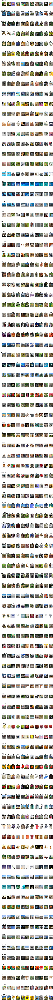

In [ ]:
sim = get_similarity_group(model, X_vis, X_train, emb_type='prediction', X_emb_tr=X_emb_tr_pae)
plot_prop_group(X_vis, Y_vis, X_train, Y_train, sim, 10, model, img_dim=(32,32,3), save_dir=None, m=None)

1/1 [==============================] - 0s 25ms/step


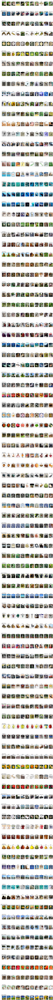

In [ ]:
sim = get_similarity_group(model, X_vis, X_train, emb_type='penultimate', X_emb_tr=X_emb_tr_penult)
plot_prop_group(X_vis, Y_vis, X_train, Y_train, sim, 10, model, img_dim=(32,32,3), save_dir=None, m=None)

1/1 [==============================] - 0s 25ms/step


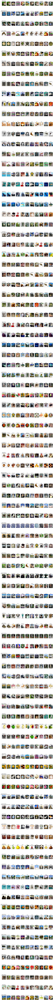

In [ ]:
sim = get_similarity_group(model, X_vis, X_train, emb_type='penultimate', X_emb_tr=X_emb_tr_penult_bn)
plot_prop_group(X_vis, Y_vis, X_train, Y_train, sim, 10, model, img_dim=(32,32,3), save_dir=None, m=None)

## Memorization

Select indices here and also run IF, RPS and TracIn on them

In [ ]:
cifar100_infl_matrix_class = np.load(BASE_DIR + "/cifar100_infl_matrix.npz", allow_pickle=True)
# from Memorization Paper (so _mp)
tr_labels_mp = cifar100_infl_matrix_class['tr_labels']
tr_ix_mp = np.array(range(len(tr_labels_mp)))
tr_mem_mp = cifar100_infl_matrix_class['tr_mem']

tt_labels_mp = cifar100_infl_matrix_class['tt_labels']
tt_ix_mp = np.array(range(len(tt_labels_mp)))

# memorization values for each training instance based on our indexing
tr_ix_mp_aligned = tr_ix_mp  # alignment required for imagenet only
tr_mp_ix_mem = {i:m for i,m in zip(tr_ix_mp_aligned, tr_mem_mp)}

high_mem_thresh = 0.9
tr_high_mem_ix = tr_ix_mp_aligned[tr_mem_mp > high_mem_thresh]

num_tr = 5
tr_mp_ix = np.random.choice(tr_high_mem_ix, num_tr, replace=False)

In [ ]:
cifar100_inf = np.load(BASE_DIR + "/cifar100_high_infl_pairs_infl0.15_mem0.25.npz", allow_pickle=True)
cifar100_infl_matrix_class = np.load(BASE_DIR + "/cifar100_infl_matrix.npz", allow_pickle=True)

In [ ]:
print(cifar100_infl_matrix_class.files)
print(cifar100_inf.files)  # will come to these examples later

['tr_labels', 'tt_labels', 'tr_mem', 'tr_classidx_0', 'tt_classidx_0', 'infl_matrix_class0', 'tr_classidx_1', 'tt_classidx_1', 'infl_matrix_class1', 'tr_classidx_2', 'tt_classidx_2', 'infl_matrix_class2', 'tr_classidx_3', 'tt_classidx_3', 'infl_matrix_class3', 'tr_classidx_4', 'tt_classidx_4', 'infl_matrix_class4', 'tr_classidx_5', 'tt_classidx_5', 'infl_matrix_class5', 'tr_classidx_6', 'tt_classidx_6', 'infl_matrix_class6', 'tr_classidx_7', 'tt_classidx_7', 'infl_matrix_class7', 'tr_classidx_8', 'tt_classidx_8', 'infl_matrix_class8', 'tr_classidx_9', 'tt_classidx_9', 'infl_matrix_class9', 'tr_classidx_10', 'tt_classidx_10', 'infl_matrix_class10', 'tr_classidx_11', 'tt_classidx_11', 'infl_matrix_class11', 'tr_classidx_12', 'tt_classidx_12', 'infl_matrix_class12', 'tr_classidx_13', 'tt_classidx_13', 'infl_matrix_class13', 'tr_classidx_14', 'tt_classidx_14', 'infl_matrix_class14', 'tr_classidx_15', 'tt_classidx_15', 'infl_matrix_class15', 'tr_classidx_16', 'tt_classidx_16', 'infl_matrix_

In [ ]:
# UNVALIDATED
# from Memorization Paper (so _mp)
tr_labels_mp = cifar100_infl_matrix_class['tr_labels']
tr_ix_mp = np.array(range(len(tr_labels_mp)))
tr_mem_mp = cifar100_infl_matrix_class['tr_mem']

tt_labels_mp = cifar100_infl_matrix_class['tt_labels']
tt_ix_mp = np.array(range(len(tt_labels_mp)))

In [ ]:
# memorization values for each training instance based on our indexing
tr_ix_mp_aligned = tr_ix_mp  # alignment required for imagenet only
tr_mp_ix_mem = {i:m for i,m in zip(tr_ix_mp_aligned, tr_mem_mp)}

#### High-Low Mem Viz

In [ ]:
# instead of just getting points with memorization 1, sample from high memorization instances
# original paper does use more diverse examples as well
high_mem_thresh = 0.9
tr_high_mem_ix = tr_ix_mp_aligned[tr_mem_mp > high_mem_thresh]

num_tr = 5
tr_mp_ix = np.random.choice(tr_high_mem_ix, num_tr, replace=False)
# X_tr_mp, Y_tr_mp = X_train[tr_mp_ix], Y_train[tr_mp_ix].argmax(axis=1)
X_tr_mp, Y_tr_mp = X_train[tr_mp_ix], Y_train[tr_mp_ix]

[0.56120545 0.04866906 0.04737448 0.03987739 0.0308205 ]
[0.29596016 0.273809   0.23364486 0.14797549 0.03476917]
[0.39559627 0.328456   0.22778882 0.02412693 0.00799049]
[0.26438907 0.16129522 0.14882484 0.13426328 0.11992223]
[0.66898495 0.07964834 0.0764996  0.04770513 0.04606249]


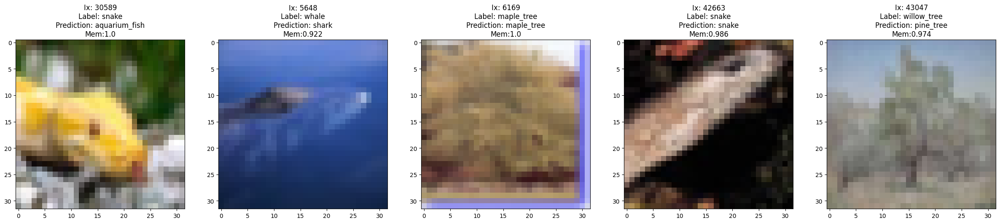

In [ ]:
plt.figure(figsize=(30,10))
num_test = X_tr_mp.shape[0]
for i in range(num_test):
  ax = plt.subplot(1, num_test, i+1)
  plt.imshow(X_tr_mp[i])
  # to check entropy in prediction (get top 5 prob values in sorted order for quick intuition)
  print(np.sort(Y_pred_tr_m[tr_mp_ix[i]])[::-1][:5])
  plt.title(f"Ix: {tr_mp_ix[i]}\nLabel: {label_dict[int(np.squeeze(np.where(Y_tr_mp[i]==1)))]}\nPrediction: {label_dict[int(Y_pred_tr_m[tr_mp_ix[i]].argmax())]}\nMem:{tr_mp_ix_mem[tr_mp_ix[i]].round(3)}")

1/1 [==============================] - 0s 36ms/step


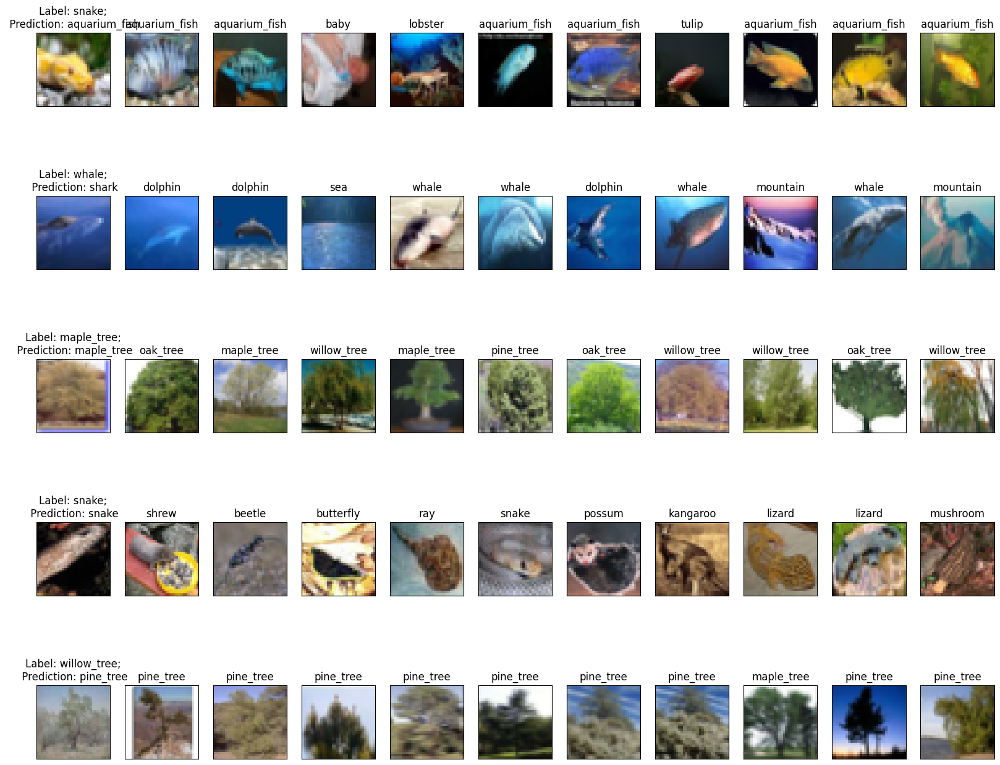

In [ ]:
# in _mp context we select "training" instances and check for similarity in "test" data
# makes life easier (computation faster) actually
# Proponents beyond first image are quite unrepresentative
# And predictions wrong (yet well explained as well?)
sim = get_similarity_group(model=model, X=X_tr_mp, X_train=X_test, dist_func=euclidean_dist, emb_type='prediction', X_emb_tr=X_emb_te_pae)
plot_prop_group(X_tr_mp, Y_tr_mp, X_test, Y_test, sim, 10, model, img_dim=(32,32,3), save_dir=None, m=None)

1/1 [==============================] - 0s 23ms/step


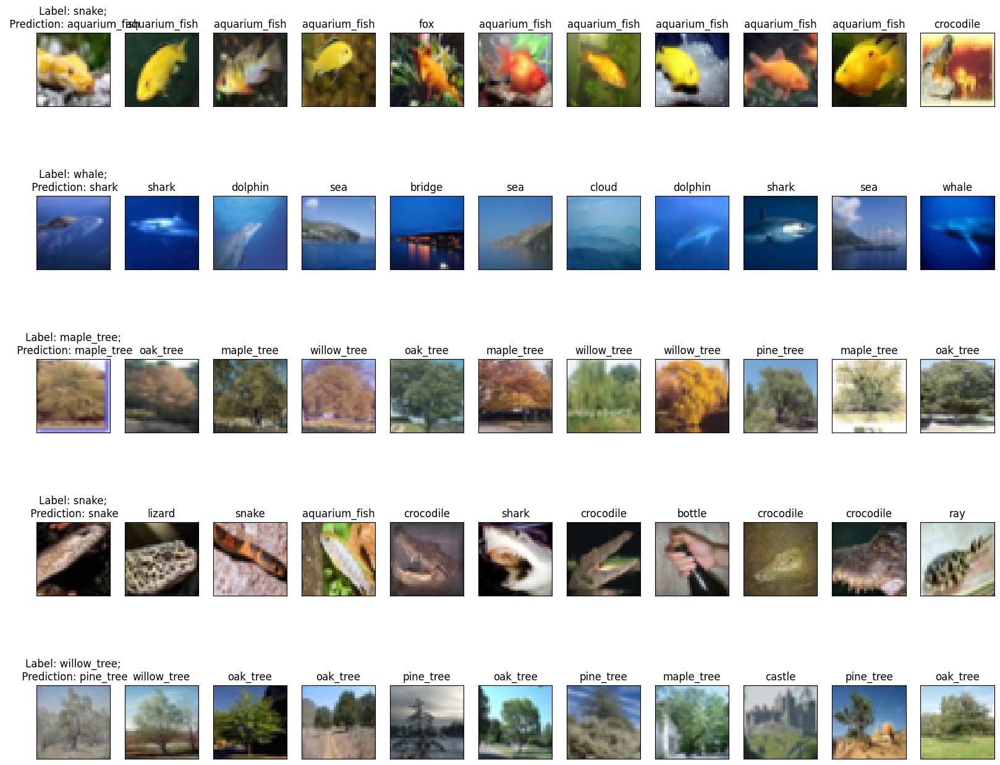

In [ ]:
sim = get_similarity_group(model=model, X=X_tr_mp, X_train=X_test, dist_func=euclidean_dist, emb_type='penultimate', X_emb_tr=X_emb_te_penult)
plot_prop_group(X_tr_mp, Y_tr_mp, X_test, Y_test, sim, 10, model, img_dim=(32,32,3), save_dir=None, m=None)

[0.40940318 0.0716535  0.04499931 0.044981   0.04137513]
[0.27943453 0.22758049 0.13382703 0.09105225 0.07950846]
[9.9783891e-01 1.6582074e-03 3.6688434e-04 1.2585745e-04 3.7368723e-06]
[0.50081396 0.22096728 0.05184304 0.03885252 0.02507506]
[9.9928999e-01 4.1811407e-04 1.5658073e-04 3.7263188e-05 2.2519980e-05]


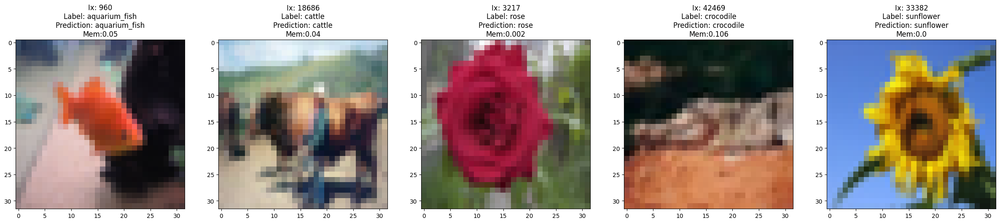

In [ ]:
# Comparison where low memorization
low_mem_thresh = 0.2
tr_low_mem_ix = tr_ix_mp_aligned[tr_mem_mp < low_mem_thresh]

num_tr = 5
tr_mp_ix = np.random.choice(tr_low_mem_ix, num_tr, replace=False)
X_tr_mp, Y_tr_mp = X_train[tr_mp_ix], Y_train[tr_mp_ix]

plt.figure(figsize=(30,10))
num_test = X_tr_mp.shape[0]
for i in range(num_test):
  ax = plt.subplot(1, num_test, i+1)
  plt.imshow(X_tr_mp[i])
  # to check entropy in prediction (get top 5 prob values in sorted order for quick intuition)
  print(np.sort(Y_pred_tr_m[tr_mp_ix[i]])[::-1][:5])
  plt.title(f"Ix: {tr_mp_ix[i]}\nLabel: {label_dict[int(np.squeeze(np.where(Y_tr_mp[i]==1)))]}\nPrediction: {label_dict[int(Y_pred_tr_m[tr_mp_ix[i]].argmax())]}\nMem:{tr_mp_ix_mem[tr_mp_ix[i]].round(3)}")

1/1 [==============================] - 0s 28ms/step


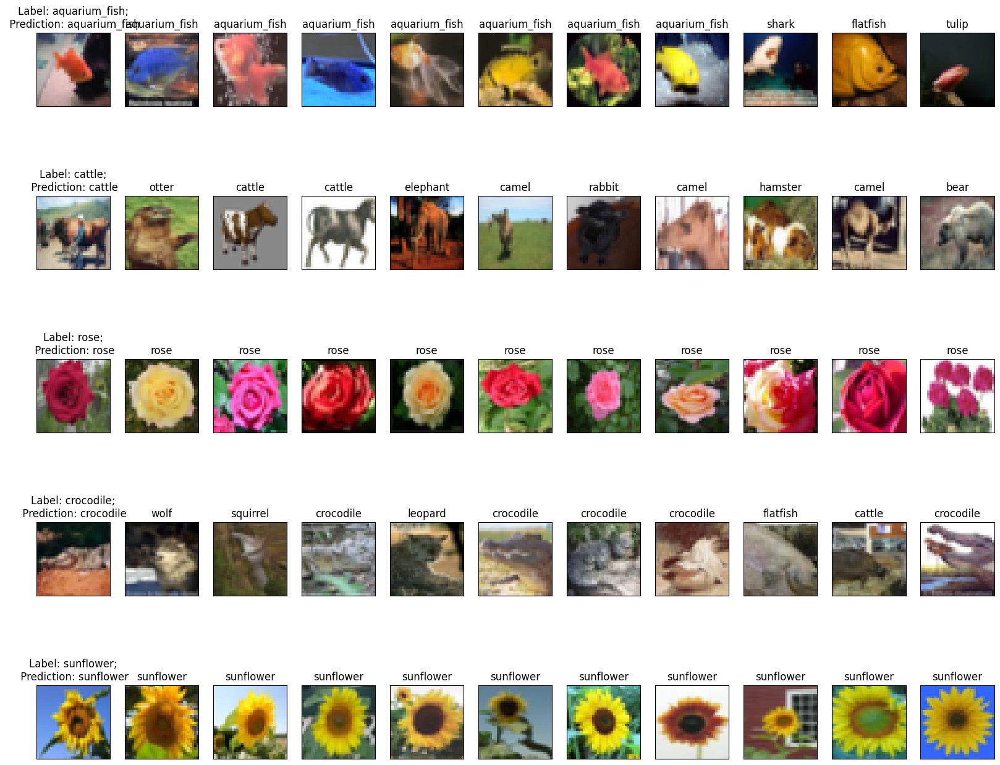

In [ ]:
sim = get_similarity_group(model=model, X=X_tr_mp, X_train=X_test, dist_func=euclidean_dist, emb_type='prediction', X_emb_tr=X_emb_te_pae)
plot_prop_group(X_tr_mp, Y_tr_mp, X_test, Y_test, sim, 10, model, img_dim=(32,32,3), save_dir=None, m=None)

1/1 [==============================] - 0s 23ms/step


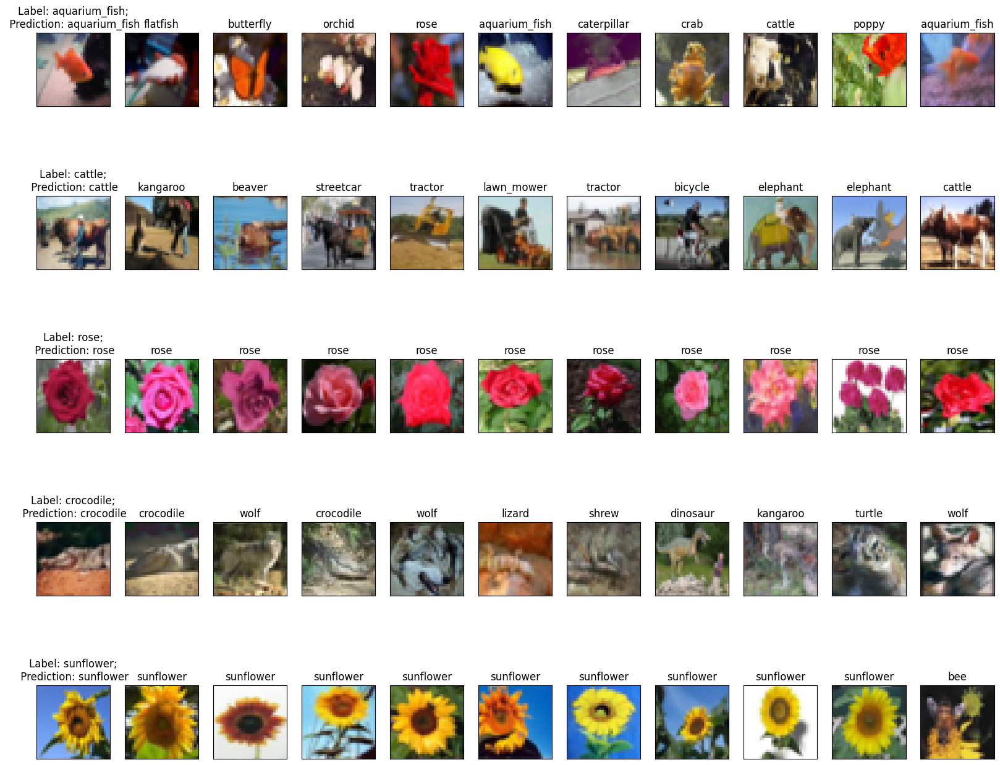

In [ ]:
sim = get_similarity_group(model=model, X=X_tr_mp, X_train=X_test, dist_func=euclidean_dist, emb_type='penultimate', X_emb_tr=X_emb_te_penult)
plot_prop_group(X_tr_mp, Y_tr_mp, X_test, Y_test, sim, 10, model, img_dim=(32,32,3), save_dir=None, m=None)

#### Similarity in Training Set
As label memorization stems from training set

[0.60667163 0.20177388 0.03841566 0.02544111 0.02185804]
[0.2783225  0.24877949 0.16507998 0.08592949 0.03190887]
[6.7188185e-01 1.9247350e-01 1.1669744e-01 1.7420027e-02 5.7029154e-04]
[0.96552634 0.00997942 0.00701492 0.00648394 0.00548951]
[0.47922975 0.14158078 0.11364304 0.07951692 0.06374976]
[0.84837437 0.01908096 0.00868085 0.00802857 0.00784268]
[0.5384269  0.07349344 0.06018011 0.05595772 0.05240984]
[0.81884885 0.04250298 0.03250949 0.02914906 0.01387393]
[0.48058373 0.200303   0.11925922 0.03567958 0.01982171]
[0.9184155  0.0377267  0.02162252 0.01350773 0.00108847]


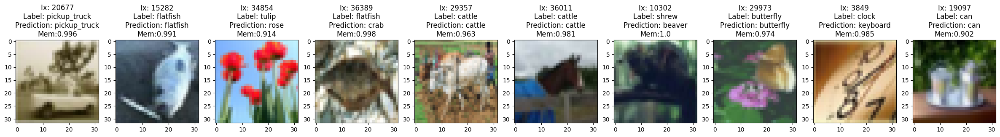

In [ ]:
# Comparison where high memorization
high_mem_thresh = 0.9
tr_high_mem_ix = tr_ix_mp_aligned[tr_mem_mp > high_mem_thresh]

num_tr = 10
tr_mp_ix = np.random.choice(tr_high_mem_ix, num_tr, replace=False)
# X_tr_mp, Y_tr_mp = X_train[tr_mp_ix], Y_train[tr_mp_ix].argmax(axis=1)
X_tr_mp, Y_tr_mp = X_train[tr_mp_ix], Y_train[tr_mp_ix]

plt.figure(figsize=(30,10))
num_test = X_tr_mp.shape[0]
for i in range(num_test):
  ax = plt.subplot(1, num_test, i+1)
  plt.imshow(X_tr_mp[i])
  # to check entropy in prediction (get top 5 prob values in sorted order for quick intuition)
  print(np.sort(Y_pred_tr_m[tr_mp_ix[i]])[::-1][:5])
  plt.title(f"Ix: {tr_mp_ix[i]}\nLabel: {label_dict[int(np.squeeze(np.where(Y_tr_mp[i]==1)))]}\nPrediction: {label_dict[int(Y_pred_tr_m[tr_mp_ix[i]].argmax())]}\nMem:{tr_mp_ix_mem[tr_mp_ix[i]].round(3)}")

1/1 [==============================] - 0s 28ms/step


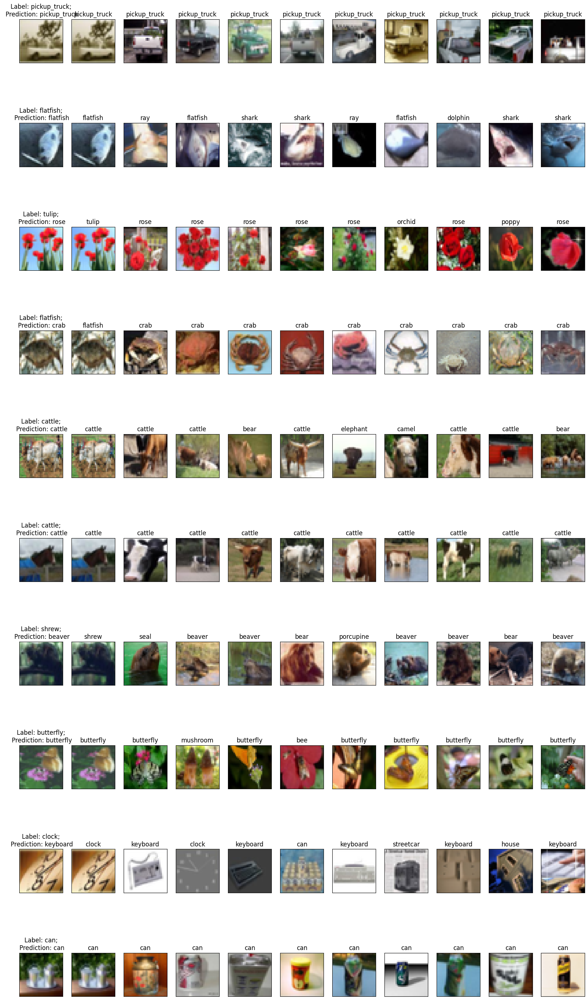

In [ ]:
sim = get_similarity_group(model=model, X=X_tr_mp, X_train=X_train, dist_func=euclidean_dist, emb_type='prediction', X_emb_tr=X_emb_tr_pae)
plot_prop_group(X_tr_mp, Y_tr_mp, X_train, Y_train, sim, 10, model, img_dim=(32,32,3), save_dir=None, m=None)

1/1 [==============================] - 0s 45ms/step


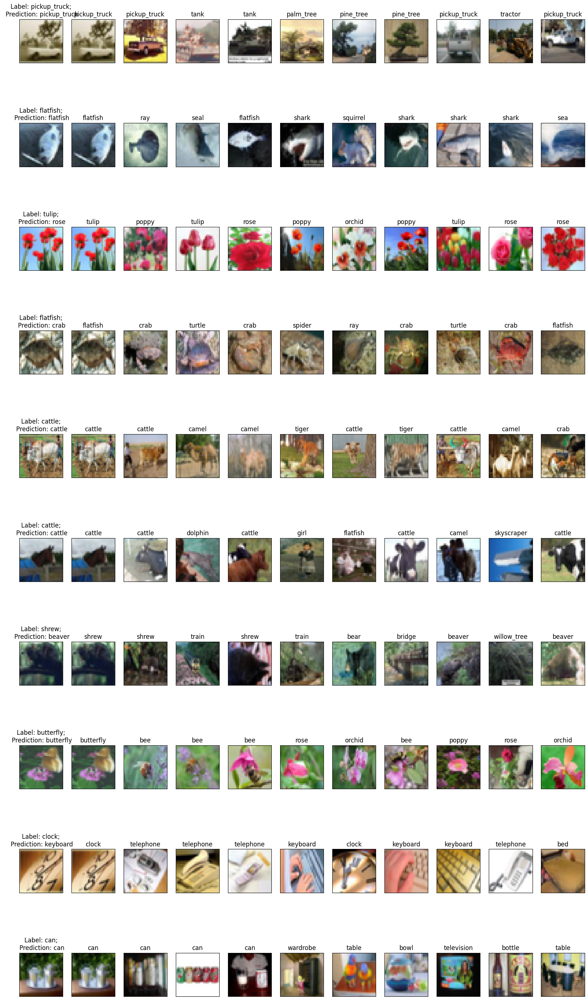

In [ ]:
sim = get_similarity_group(model=model, X=X_tr_mp, X_train=X_train, dist_func=euclidean_dist, emb_type='penultimate', X_emb_tr=X_emb_tr_penult)
plot_prop_group(X_tr_mp, Y_tr_mp, X_train, Y_train, sim, 10, model, img_dim=(32,32,3), save_dir=None, m=None)

[9.9722952e-01 2.5007604e-03 9.0610716e-05 5.5317061e-05 2.7955550e-05]
[0.96986157 0.01359433 0.00579403 0.00373078 0.00228557]
[0.754196   0.11157615 0.03775265 0.0306012  0.02780864]
[0.806816   0.10836537 0.02738103 0.01303098 0.00910895]
[0.9771552  0.01031986 0.00419408 0.00333807 0.00152363]


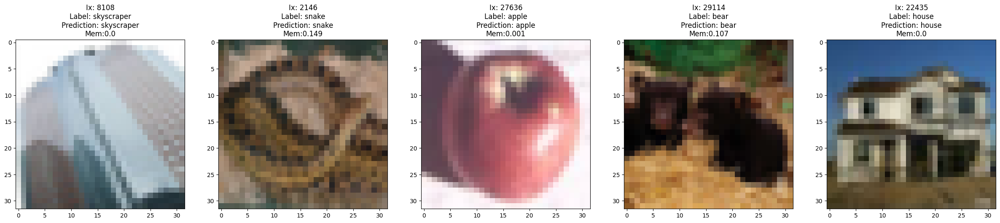

In [ ]:
# Comparison where low memorization
low_mem_thresh = 0.2
tr_low_mem_ix = tr_ix_mp_aligned[tr_mem_mp < low_mem_thresh]

num_tr = 5
tr_mp_ix = np.random.choice(tr_low_mem_ix, num_tr, replace=False)
X_tr_mp, Y_tr_mp = X_train[tr_mp_ix], Y_train[tr_mp_ix]

plt.figure(figsize=(30,10))
num_test = X_tr_mp.shape[0]
for i in range(num_test):
  ax = plt.subplot(1, num_test, i+1)
  plt.imshow(X_tr_mp[i])
  # to check entropy in prediction (get top 5 prob values in sorted order for quick intuition)
  print(np.sort(Y_pred_tr_m[tr_mp_ix[i]])[::-1][:5])
  plt.title(f"Ix: {tr_mp_ix[i]}\nLabel: {label_dict[int(np.squeeze(np.where(Y_tr_mp[i]==1)))]}\nPrediction: {label_dict[int(Y_pred_tr_m[tr_mp_ix[i]].argmax())]}\nMem:{tr_mp_ix_mem[tr_mp_ix[i]].round(3)}")

1/1 [==============================] - 0s 24ms/step


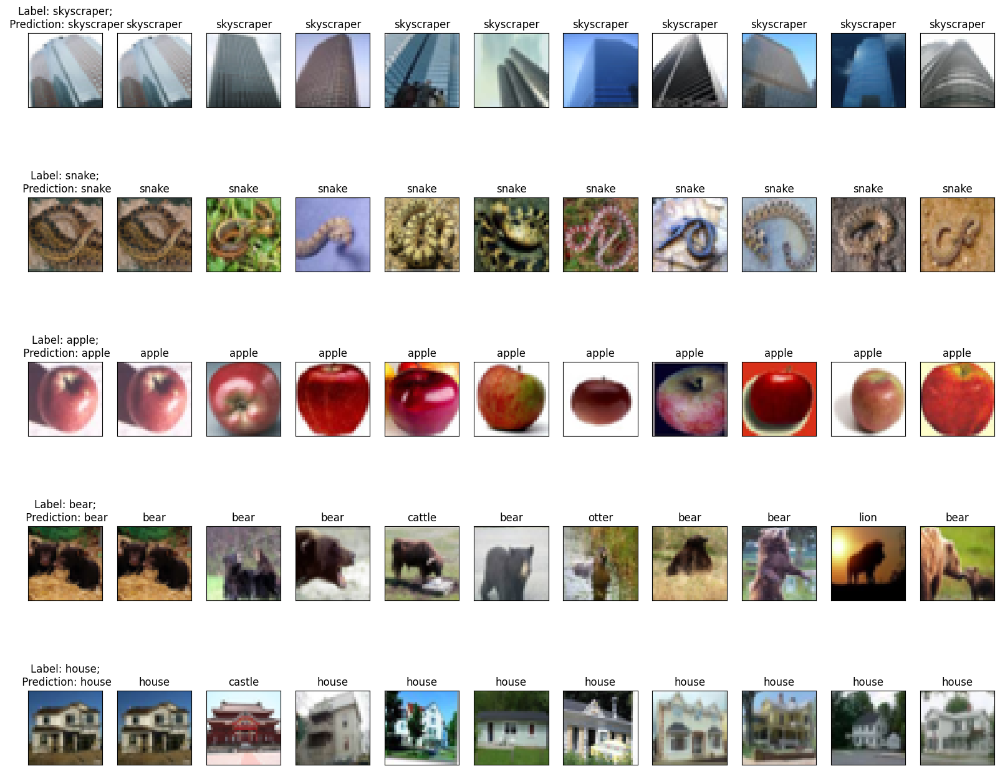

In [ ]:
sim = get_similarity_group(model=model, X=X_tr_mp, X_train=X_train, dist_func=euclidean_dist, emb_type='prediction', X_emb_tr=X_emb_tr_pae)
plot_prop_group(X_tr_mp, Y_tr_mp, X_train, Y_train, sim, 10, model, img_dim=(32,32,3), save_dir=None, m=None)

1/1 [==============================] - 0s 25ms/step


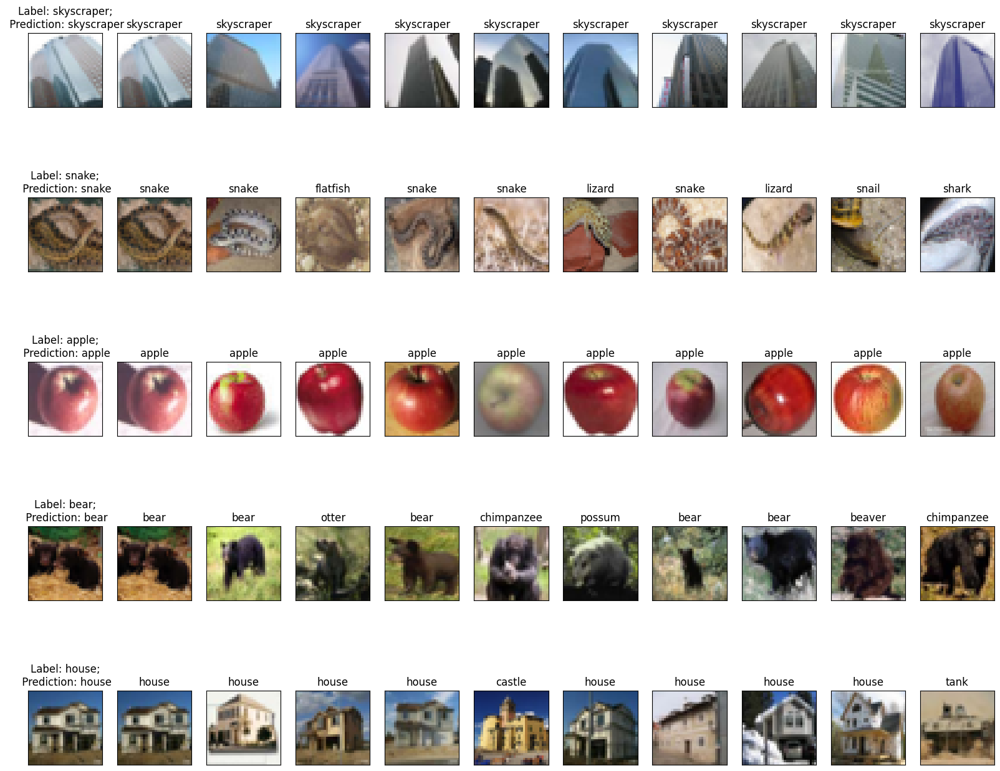

In [ ]:
sim = get_similarity_group(model=model, X=X_tr_mp, X_train=X_train, dist_func=euclidean_dist, emb_type='penultimate', X_emb_tr=X_emb_tr_penult)
plot_prop_group(X_tr_mp, Y_tr_mp, X_train, Y_train, sim, 10, model, img_dim=(32,32,3), save_dir=None, m=None)

In [ ]:
# testing diversity in a class
rand_c = np.random.randint(0, NUM_CLASSES)
ixs_c = Y_train.argmax(axis=1)==rand_c

ixs_c_low = tr_ix_mp_aligned[ixs_c & (tr_mem_mp < 0.2)]
ixs_c_med = tr_ix_mp_aligned[ixs_c & (tr_mem_mp > 0.4) & (tr_mem_mp < 0.6)]
ixs_c_high = tr_ix_mp_aligned[ixs_c & (tr_mem_mp > 0.8)]

# print(ixs_c_low, ixs_c_med, ixs_c_high)  # verify that sufficient diversity in this class

[0.84239626 0.1334415  0.00719393 0.00402514 0.00262467]
[9.8574835e-01 1.0435434e-02 1.4800022e-03 1.1118588e-03 3.0740409e-04]
[9.9676895e-01 2.3869218e-03 3.9759272e-04 1.8491488e-04 1.5846291e-04]
[0.66188586 0.29300508 0.03429175 0.00270772 0.00149241]
[0.58044225 0.31925008 0.03693859 0.03038611 0.00797304]
[0.4823262  0.3827432  0.1138068  0.00672973 0.00609743]
[0.58612734 0.29119527 0.08888821 0.02088347 0.00151776]
[0.3776082  0.15265825 0.1446339  0.1212692  0.08743145]
[0.89266235 0.05916606 0.03032128 0.01064296 0.00287408]


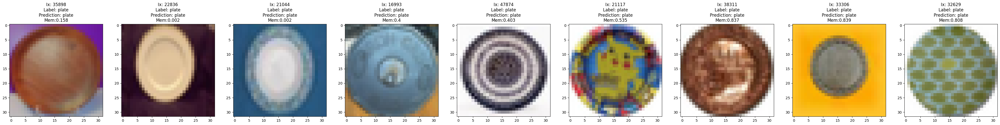

In [ ]:
ixs_low = np.random.choice(ixs_c_low, 3, replace=False)
ixs_med = np.random.choice(ixs_c_med, 3, replace=False)
ixs_high = np.random.choice(ixs_c_high, 3, replace=False)
tr_mp_ix = np.concatenate([ixs_low, ixs_med, ixs_high])

X_tr_mp, Y_tr_mp = X_train[tr_mp_ix], Y_train[tr_mp_ix]

plt.figure(figsize=(50,50))
num_test = X_tr_mp.shape[0]
for i in range(num_test):
  ax = plt.subplot(1, num_test, i+1)
  plt.imshow(X_tr_mp[i])
  # to check entropy in prediction (get top 5 prob values in sorted order for quick intuition)
  print(np.sort(Y_pred_tr_m[tr_mp_ix[i]])[::-1][:5])
  plt.title(f"Ix: {tr_mp_ix[i]}\nLabel: {label_dict[int(np.squeeze(np.where(Y_tr_mp[i]==1)))]}\nPrediction: {label_dict[int(Y_pred_tr_m[tr_mp_ix[i]].argmax())]}\nMem:{tr_mp_ix_mem[tr_mp_ix[i]].round(3)}")

1/1 [==============================] - 0s 27ms/step


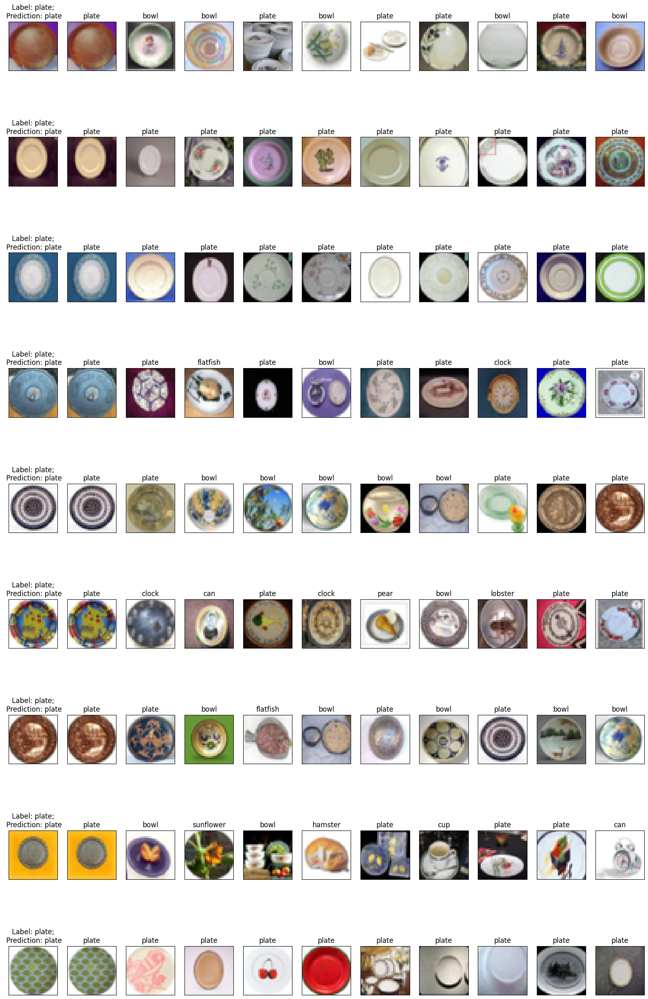

In [ ]:
sim = get_similarity_group(model=model, X=X_tr_mp, X_train=X_train, dist_func=euclidean_dist, emb_type='prediction', X_emb_tr=X_emb_tr_pae)
plot_prop_group(X_tr_mp, Y_tr_mp, X_train, Y_train, sim, 10, model, img_dim=(32,32,3), save_dir=None, m=None)

#### High Influence Train-Test Pairs

In [ ]:
mp_high_tr_idx = cifar100_inf['tr_idx']
mp_high_tt_idx = cifar100_inf['tt_idx']
mp_high_inf = cifar100_inf['infl']
mp_high_mem = cifar100_inf['mem']

mp_high_tr_idx_aligned = mp_high_tr_idx
mp_high_tt_idx_aligned = mp_high_tt_idx

In [ ]:
num_tr = 5
tr_mp_ix_high = np.random.choice(mp_high_tr_idx_aligned, num_tr, replace=False)
X_tr_mp_high, Y_tr_mp_high = X_train[tr_mp_ix_high], Y_train[tr_mp_ix_high]

[0.2506176  0.24349776 0.210703   0.05076759 0.04744146]
[6.3199782e-01 2.6578620e-01 8.7449349e-02 1.4162337e-02 4.2059936e-04]
[0.5968224  0.22245672 0.10700018 0.05225119 0.00722116]
[0.25823012 0.13856015 0.12460237 0.08525707 0.083318  ]
[0.26005858 0.21842416 0.09929965 0.08624601 0.07284407]


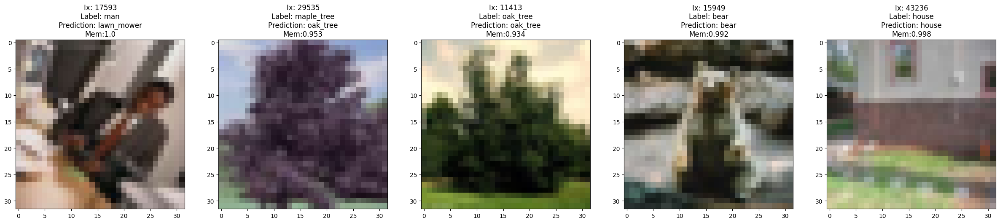

In [ ]:
plt.figure(figsize=(30,10))
num_test = X_tr_mp_high.shape[0]
for i in range(num_test):
  ax = plt.subplot(1, num_test, i+1)
  plt.imshow(X_tr_mp_high[i])
  # to check entropy in prediction (get top 5 prob values in sorted order for quick intuition)
  print(np.sort(Y_pred_tr_m[tr_mp_ix_high[i]])[::-1][:5])
  plt.title(f"Ix: {tr_mp_ix_high[i]}\nLabel: {label_dict[int(np.squeeze(np.where(Y_tr_mp_high[i]==1)))]}\nPrediction: {label_dict[int(Y_pred_tr_m[tr_mp_ix_high[i]].argmax())]}\nMem:{tr_mp_ix_mem[tr_mp_ix_high[i]].round(3)}")
  # unlike imagenet, top proponent was NOT high memory/influence pair
  # remember that for recoveries in imagenet, all information leak instances where identical scenes were found; not recovered where perceptually become quite different example very zoomed in (makes sense due to how we train and pixel level information is important)

[0.26141196 0.1148878  0.09874107 0.08379914 0.07404804]
[0.5850062  0.36358654 0.041237   0.00808652 0.00118216]
[0.4552037  0.36691517 0.10334495 0.05835566 0.00450868]
[0.35062173 0.08722834 0.06423359 0.06418557 0.06007562]
[0.5321254  0.1353713  0.12445866 0.06398462 0.04603264]


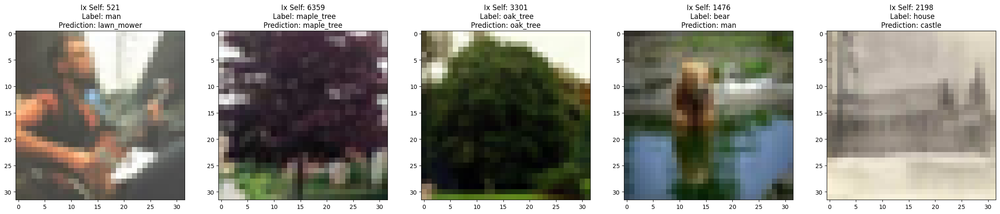

In [ ]:
# also plotting the related test images
top_te_ix = [mp_high_tt_idx_aligned[mp_high_tr_idx_aligned==x][0] for x in tr_mp_ix_high]
X_te_mp_high, Y_te_mp_high = X_test[top_te_ix], Y_test[top_te_ix]

plt.figure(figsize=(30,10))
for i in range(num_test):
  ax = plt.subplot(1, num_test, i+1)
  plt.imshow(X_te_mp_high[i])
  # to check entropy in prediction (get top 5 prob values in sorted order for quick intuition)
  print(np.sort(Y_pred_te_m[top_te_ix[i]])[::-1][:5])
  plt.title(f"Ix Self: {top_te_ix[i]}\n Label: {label_dict[int(np.squeeze(np.where(Y_te_mp_high[i]==1)))]}\nPrediction: {label_dict[int(Y_pred_te_m[top_te_ix[i]].argmax())]}")

1/1 [==============================] - 0s 27ms/step


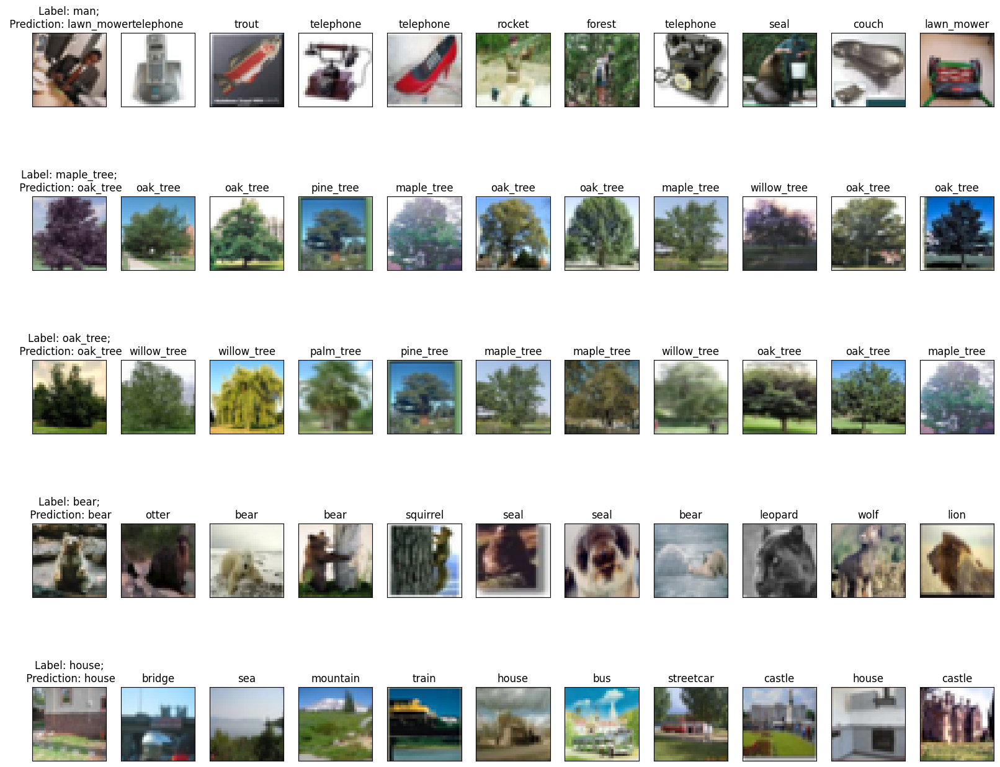

In [ ]:
sim = get_similarity_group(model=model, X=X_tr_mp_high, X_train=X_test, dist_func=euclidean_dist, emb_type='prediction', X_emb_tr=X_emb_te_pae)
plot_prop_group(X_tr_mp_high, Y_tr_mp_high, X_test, Y_test, sim, 10, model, img_dim=(32,32,3), save_dir=None, m=None)

1/1 [==============================] - 0s 28ms/step


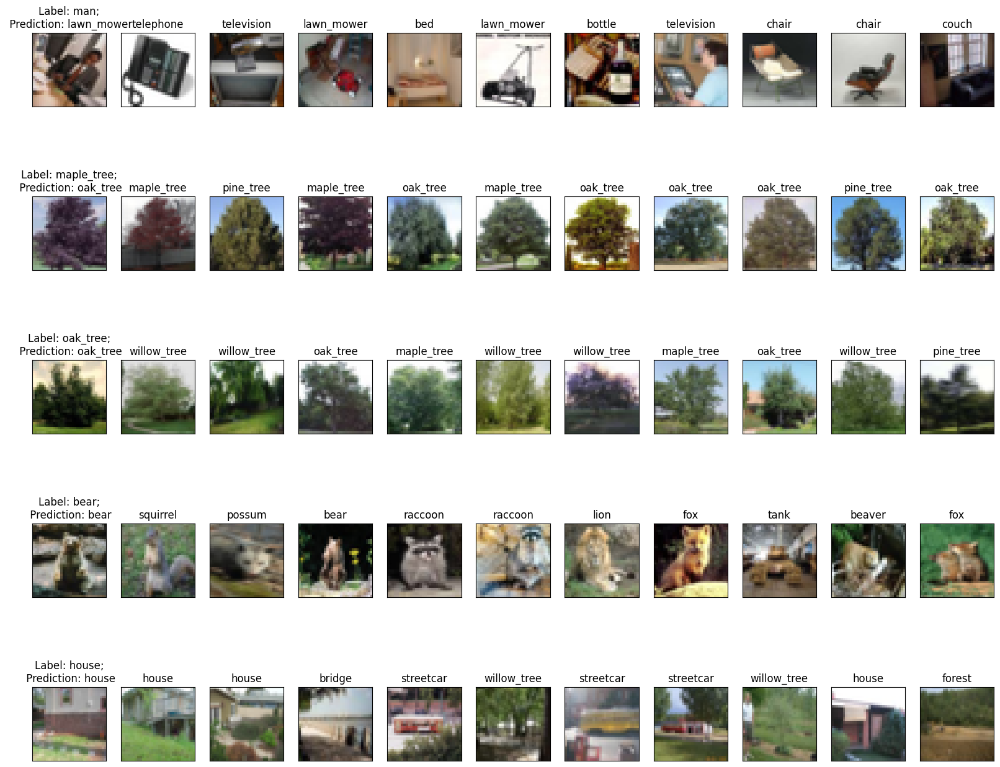

In [ ]:
sim = get_similarity_group(model=model, X=X_tr_mp_high, X_train=X_test, dist_func=euclidean_dist, emb_type='penultimate', X_emb_tr=X_emb_te_penult)
plot_prop_group(X_tr_mp_high, Y_tr_mp_high, X_test, Y_test, sim, 10, model, img_dim=(32,32,3), save_dir=None, m=None)

#### Memorization Heuristic

In [ ]:
# uses get_similarity_group
def get_similar_group(X, Y, model, X_emb_train, Y_train, n, emb_type='pae', sim_type='prop', dist_type='euclidean'):
    Y_pred_m = np.argmax(model(X), axis=1)

    num_test = X.shape[0]
    if dist_type == 'euclidean':
      # sim_group = get_similarity_group(X_emb, X_emb_train)
      sim_group = get_similarity_group(model=model, X=X, X_train=None, dist_func=euclidean_dist, emb_type=emb_type, X_emb_tr=X_emb_train)
    elif dist_type == 'cosine':
      raise NotImplementedError()
      # higher value indicates higher similarity (multiply by -1 so code consistent with euclidean distance)
      # sim_group = get_similarity_group(X_emb, X_emb_train, dist_type='cosine')
      # sim_group *= -1

    if sim_type == 'prop':
      best_n_ix_group = np.argsort(sim_group)[:,:n]
      best_n_val_group = np.sort(sim_group)[:,:n]
    elif sim_type == 'opp':
      best_n_ix_group = np.zeros((num_test, n))
      best_n_val_group = np.zeros((num_test, n))
      for i in range(num_test):
        sim = sim_group[i]
        same_class = Y_train[:,0]==Y_pred_m[i]
        # hacky way, to circumvent elements from same class
        sim[same_class] = np.inf
        most_similar_cond_ix = np.argsort(sim)
        # best w.r.t. opponents selection
        best_n_ix = most_similar_cond_ix[:n]
        best_n_ix_group[i] = best_n_ix
        best_n_val_group[i] = np.sort(sim)[:n]
      # float by default, which cannot be used for indexing
      best_n_ix_group = best_n_ix_group.astype(int)
    elif sim_type == 'hyp':
      best_n_ix_group = np.zeros((num_test, n))
      best_n_val_group = np.zeros((num_test, n))
      for i in range(num_test):
        sim = sim_group[i]
        same_class = Y_train[:,0]==Y_pred_m[i]
        # hacky way, to circumvent elements from different class
        sim[~same_class] = 0
        most_similar_cond_ix = np.argsort(sim)
        most_similar_cond_val = np.sort(sim)
        least_similar_cond_ix = most_similar_cond_ix[::-1]
        least_similar_cond_val = most_similar_cond_val[::-1]
        # best w.r.t. hypocrites selection
        best_n_ix = least_similar_cond_ix[:n]
        best_n_ix_group[i] = best_n_ix
        best_n_val_group[i] = least_similar_cond_val[:n]
      # float by default, which cannot be used for indexing
      best_n_ix_group = best_n_ix_group.astype(int)

    if dist_type == 'cosine':
      best_n_val_group *= -1

    return best_n_ix_group, best_n_val_group

##### Misc Exploration

Class: 48
[0.84239626 0.1334415  0.00719393 0.00402514 0.00262467]
[9.8574835e-01 1.0435434e-02 1.4800022e-03 1.1118588e-03 3.0740409e-04]
[9.9676895e-01 2.3869218e-03 3.9759272e-04 1.8491488e-04 1.5846291e-04]
[0.66188586 0.29300508 0.03429175 0.00270772 0.00149241]
[0.58044225 0.31925008 0.03693859 0.03038611 0.00797304]
[0.4823262  0.3827432  0.1138068  0.00672973 0.00609743]
[0.58612734 0.29119527 0.08888821 0.02088347 0.00151776]
[0.3776082  0.15265825 0.1446339  0.1212692  0.08743145]
[0.89266235 0.05916606 0.03032128 0.01064296 0.00287408]


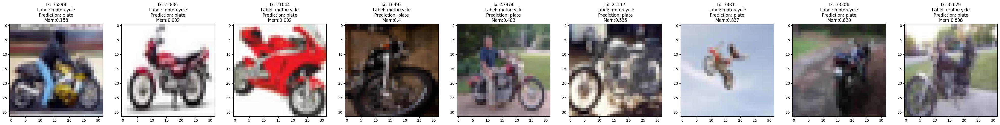

In [ ]:
# testing diversity in a class
class_num = np.random.randint(0, NUM_CLASSES)
print(f"Class: {class_num}")
ixs_c = Y_train.argmax(axis=1)==class_num

ixs_c_low = tr_ix_mp_aligned[ixs_c & (tr_mem_mp < 0.2)]
ixs_c_med = tr_ix_mp_aligned[ixs_c & (tr_mem_mp > 0.4) & (tr_mem_mp < 0.6)]
ixs_c_high = tr_ix_mp_aligned[ixs_c & (tr_mem_mp > 0.8)]

ixs_low = np.random.choice(ixs_c_low, 3, replace=False)
ixs_med = np.random.choice(ixs_c_med, 3, replace=False)
ixs_high = np.random.choice(ixs_c_high, 3, replace=False)
tr_ixs = np.concatenate([ixs_low, ixs_med, ixs_high])

X_tr_mix, Y_tr_mix = X_train[tr_ixs], Y_train[tr_ixs]

plt.figure(figsize=(50,50))
num_test = X_tr_mp.shape[0]
for i in range(num_test):
  ax = plt.subplot(1, num_test, i+1)
  plt.imshow(X_tr_mix[i])
  # to check entropy in prediction (get top 5 prob values in sorted order for quick intuition)
  print(np.sort(Y_pred_tr_m[tr_mp_ix[i]])[::-1][:5])
  plt.title(f"Ix: {tr_mp_ix[i]}\nLabel: {label_dict[int(np.squeeze(np.where(Y_tr_mix[i]==1)))]}\nPrediction: {label_dict[int(Y_pred_tr_m[tr_mp_ix[i]].argmax())]}\nMem:{tr_mp_ix_mem[tr_mp_ix[i]].round(3)}")

In [ ]:
best_ix, best_val = get_similar_group(X_tr_mix, Y_tr_mix, model, X_emb_tr_pae, Y_train, n=20, emb_type='prediction')
# best_ix, best_val = get_similar_group(X_tr_mix, Y_tr_mix, model, X_emb_tr_penult, Y_train, n=20, emb_type='penultimate')

In [ ]:
mem_val = np.array([tr_mp_ix_mem[i] for i in tr_ixs])

1/1 [==============================] - 0s 36ms/step
5
1/1 [==============================] - 0s 51ms/step
10
1/1 [==============================] - 0s 45ms/step
15
1/1 [==============================] - 0s 35ms/step
20
1/1 [==============================] - 0s 24ms/step
25
1/1 [==============================] - 0s 30ms/step
30
1/1 [==============================] - 0s 23ms/step
35
1/1 [==============================] - 0s 24ms/step
40
1/1 [==============================] - 0s 23ms/step
45
1/1 [==============================] - 0s 27ms/step
50
1/1 [==============================] - 0s 23ms/step
55
1/1 [==============================] - 0s 24ms/step
60
1/1 [==============================] - 0s 39ms/step
65
1/1 [==============================] - 0s 31ms/step
70
1/1 [==============================] - 0s 23ms/step
75
1/1 [==============================] - 0s 23ms/step
80
1/1 [==============================] - 0s 28ms/step
85
1/1 [==============================] - 0s 27ms/step
90
1/1 [======

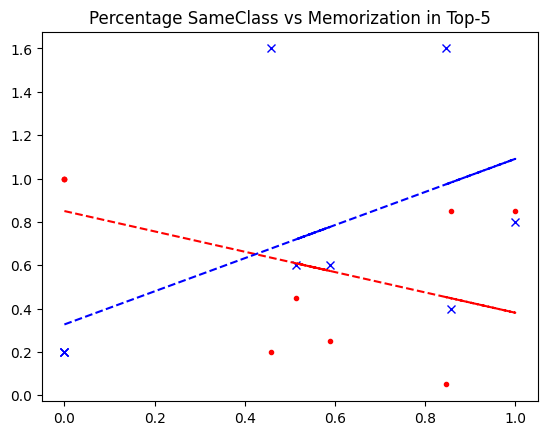

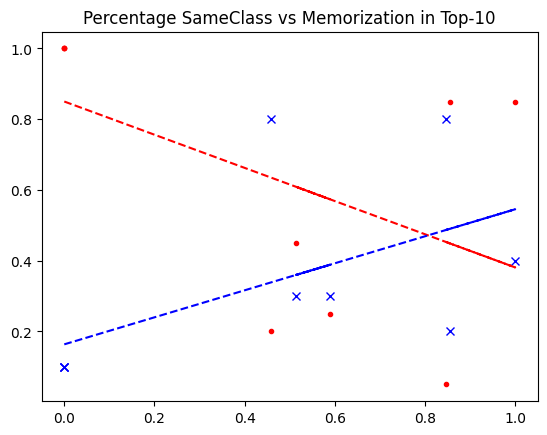

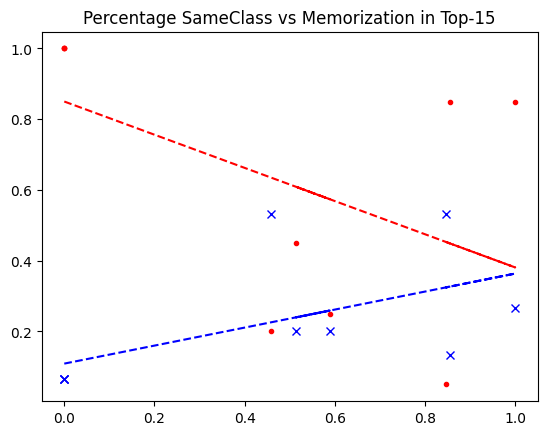

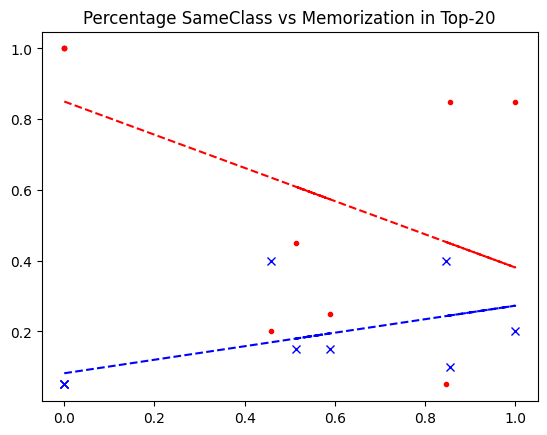

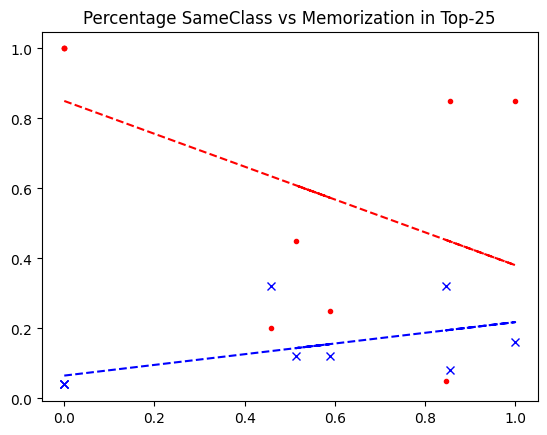

...

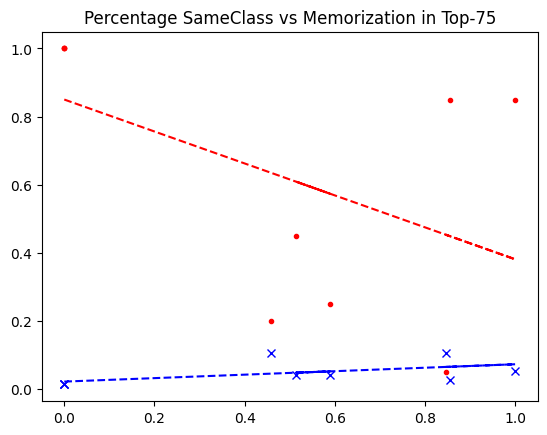

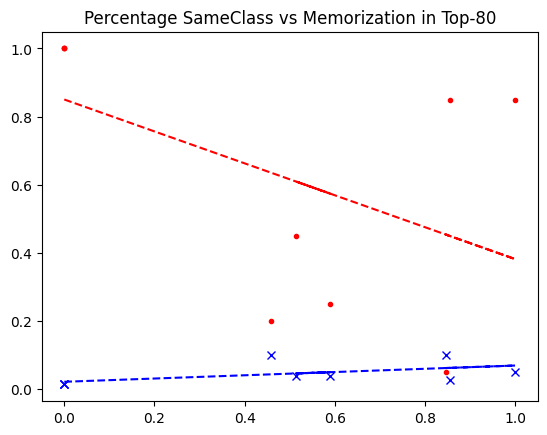

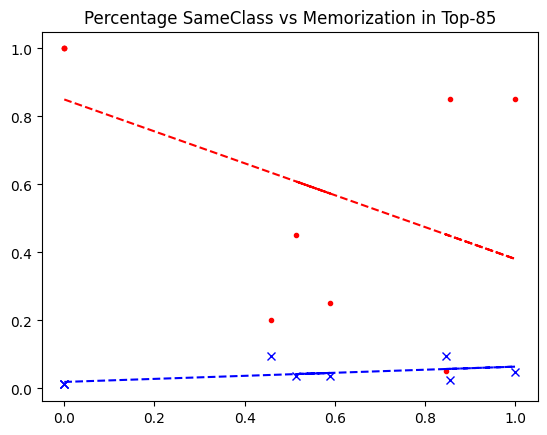

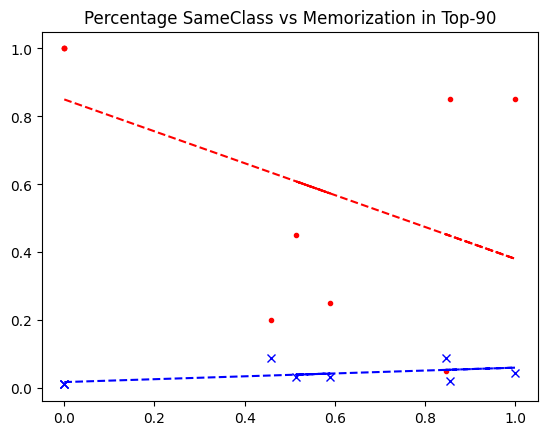

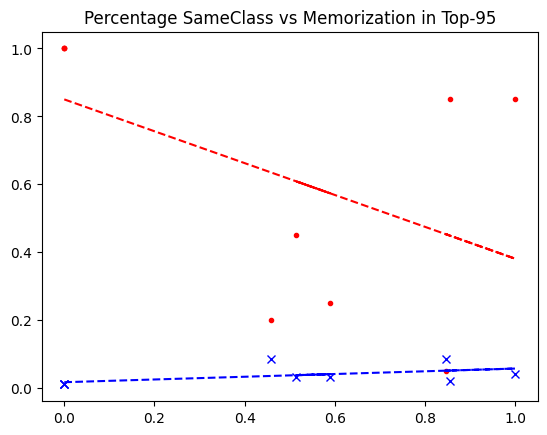

In [ ]:
# k=15 or 20 appears to be a good choice
for k in list(range(5,100,5)):
  print(k)
  best_ix_k, best_val_k = get_similar_group(X_tr_mp, Y_tr_mp, model, X_emb_tr_pae, Y_train, n=k, emb_type='prediction')
  # best_ix_k, best_val_k = get_similar_group(X_tr_mp, Y_tr_mp, model, X_emb_tr_penult, Y_train, n=k, emb_type='penultimate')

  pct_sameclass_label_k = np.array([(Y_train.argmax(axis=1)[best_ix[i]] == class_num).mean() for i in range(len(best_ix_k))])
  num_classes_label_k = np.array([len(np.unique(Y_train.argmax(axis=1)[best_ix[i]])) for i in range(len(best_ix_k))]) / k   # division for normalizing over num_examples
  plt.figure()
  plt.title(f"Percentage SameClass vs Memorization in Top-{k}")
  plt.plot(mem_val, pct_sameclass_label_k, 'r.')
  plt.plot(mem_val, num_classes_label_k, 'bx')
  # lines of best fit
  a1, b1 = np.polyfit(mem_val, pct_sameclass_label_k, 1)
  plt.plot(mem_val, a1*mem_val + b1, 'r--')
  a2, b2 = np.polyfit(mem_val, num_classes_label_k, 1)
  plt.plot(mem_val, a2*mem_val + b2, 'b--')

In [ ]:
# only whether belongs to labeled class (diversity/entropy in top-k another factor)
pct_sameclass = [(Y_train.argmax(axis=1)[best_ix[i]]==class_num).mean() for i in range(len(best_ix))]
pct_sameclass_pred_m = [(Y_pred_tr_m.argmax(axis=1)[best_ix[i]]==class_num).mean() for i in range(len(best_ix))]
# pct_sameclass_pred_ma = [(Y_tr[:,2][best_ix[i]]==class_num).mean() for i in range(len(best_ix))]

In [ ]:
num_classes = np.array([len(np.unique(Y_train.argmax(axis=1)[best_ix[i]])) for i in range(len(best_ix))])
num_classes_pred_m = np.array([len(np.unique(Y_pred_tr_m.argmax(axis=1)[best_ix[i]])) for i in range(len(best_ix))])
# num_classes_pred_ma = np.array([len(np.unique(Y_tr[:,2][best_ix[i]])) for i in range(len(best_ix))])

In [ ]:
print(pct_sameclass)
print(pct_sameclass_pred_m)
# print(pct_sameclass_pred_ma)

[1.0, 1.0, 1.0, 0.9, 1.0, 0.7, 0.1, 0.05, 0.65]
[1.0, 1.0, 1.0, 1.0, 1.0, 0.9, 0.0, 0.0, 0.65]


Text(0.5, 0, '')

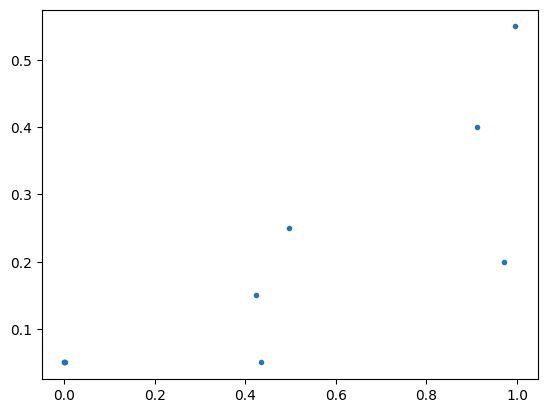

In [ ]:
plt.figure()
plt.plot(mem_val, num_classes/20, '.')
plt.xlabel('')

##### Correlation Random Subset

In [ ]:
#####
# Checking trend on more comprehensive data
#####

In [ ]:
num_tr = 500  # increase with higher ram; out of memory issues for entire dataset (but could possibly combine results for cifar100 entire data unlike imagenet)
k = 15

In [ ]:
start = time.time()
tr_ixs = np.random.choice(range(X_train.shape[0]), num_tr, replace=False)
# tr_ixs = np.random.choice(range(10000), num_tr, replace=False)   # temp, to access data faster
X_tr_mix, Y_tr_mix = X_train[tr_ixs], Y_train[tr_ixs]

In [ ]:
tr_ixs.shape

(500,)

(array([270.,  37.,  23.,  15.,  19.,   9.,  13.,  10.,  10.,  12.,   8.,
         12.,  12.,  12.,  38.]),
 array([0.        , 0.06666667, 0.13333333, 0.2       , 0.26666667,
        0.33333333, 0.4       , 0.46666667, 0.53333333, 0.6       ,
        0.66666667, 0.73333333, 0.8       , 0.86666667, 0.93333333,
        1.        ]),
 <BarContainer object of 15 artists>)

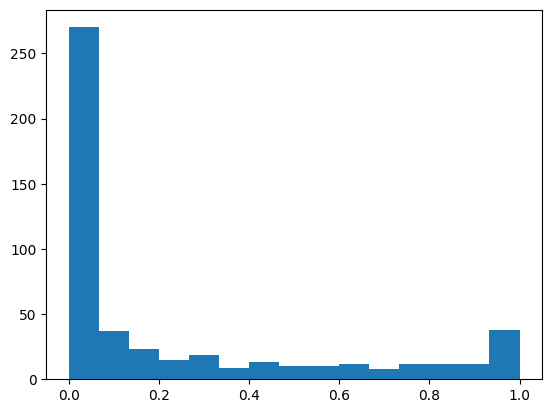

In [ ]:
mem_val = np.array([tr_mp_ix_mem[i] for i in tr_ixs])
plt.hist(mem_val, bins=15)

In [ ]:
start = time.time()
best_ix, best_val = get_similar_group(X_tr_mix, Y_tr_mix, model, X_emb_tr_pae, Y_train, n=k, emb_type='prediction')
# best_ix, best_val = get_similar_group(X_tr_mix, Y_tr_mix, model, X_emb_tr_penult, Y_train, n=k, emb_type='penultimate')
print(f"Time taken: {np.round(time.time() - start, 4)}s")

16/16 [==============================] - 1s 94ms/step
Time taken: 10.2835s


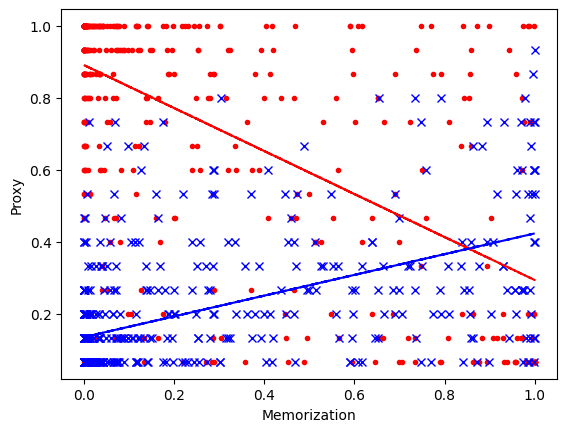

In [ ]:
pct_sameclass_label = np.array([(Y_train.argmax(axis=1)[best_ix[i]]==Y_tr_mix[i].argmax()).mean() for i in range(len(best_ix))])
num_classes_label = np.array([len(np.unique(Y_train.argmax(axis=1)[best_ix[i]])) for i in range(len(best_ix))])
num_classes_label = num_classes_label/k  # normalize
plt.figure()
plt.xlabel('Memorization')
plt.ylabel('Proxy')
plt.plot(mem_val, pct_sameclass_label, 'r.')
plt.plot(mem_val, num_classes_label, 'bx')
# lines of best fit
a1, b1 = np.polyfit(mem_val, pct_sameclass_label, 1)
plt.plot(mem_val, a1*mem_val + b1, 'r--')
a2, b2 = np.polyfit(mem_val, num_classes_label, 1)
plt.plot(mem_val, a2*mem_val + b2, 'b--')

In [ ]:
# correlation value would be better measure than just seeing line of best fit (with 1000 instances)
# mostly tail identification rather than memorization per se (and our results likely to improve with more accurate model)
# since 0.73 model (resnet50) accuracy so correlation even more impressive in that context
# plus likely room for improvement with smarter heuristic including combining the current ones (italicize this, that this is not focus of our paper but can likely be improved)
print(np.corrcoef(mem_val, pct_sameclass_label)[0,1])
print(np.corrcoef(mem_val, 1-pct_sameclass_label)[0,1])
print(np.corrcoef(mem_val, num_classes_label)[0,1])

-0.6089195148439137
0.6089195148439138
0.5224294791129422


In [ ]:
import scipy.stats as ss
print('Spearman-R')
print(ss.spearmanr(mem_val, 1-pct_sameclass_label))
print(ss.spearmanr(mem_val, num_classes_label))
print('Kendall-Tau')
print(ss.kendalltau(mem_val, 1-pct_sameclass_label))
print(ss.kendalltau(mem_val, num_classes_label))
print('Pearson-R')
print(ss.pearsonr(mem_val, 1-pct_sameclass_label))
print(ss.pearsonr(mem_val, num_classes_label))

Spearman-R
SignificanceResult(statistic=0.6316997941167257, pvalue=4.81960100037341e-57)
SignificanceResult(statistic=0.6078130194912132, pvalue=7.949079672707566e-52)
Kendall-Tau
SignificanceResult(statistic=0.4993397935026513, pvalue=9.572046861053415e-51)
SignificanceResult(statistic=0.4755081742243082, pvalue=2.6567906046633324e-45)
Pearson-R
PearsonRResult(statistic=0.6089195148439137, pvalue=4.6601663813252184e-52)
PearsonRResult(statistic=0.5224294791129429, pvalue=2.3168345440628865e-36)


In [ ]:
# most examples will have low memorization
# compare with mostly predicting a low memorization
print(np.corrcoef(mem_val, np.random.uniform(0,0.1,len(mem_val)))[0,1])

0.09531946782291752


##### Correlation Random Top-k% Memorized

In [ ]:
# num_tr = 1000
num_tr = 500
k = 15

In [ ]:
min_percentile_mem = 0
mem_thresh = np.percentile(tr_mem_mp, min_percentile_mem)
tr_ixs_all = tr_ix_mp_aligned[tr_mem_mp > mem_thresh]

tr_ixs = np.random.choice(tr_ixs_all, size=num_tr, replace=False)
# tr_ixs = np.sort(tr_ixs_all)[:num_tr]   # temp, to access data faster
X_tr_mix, Y_tr_mix = X_train[tr_ixs], Y_train[tr_ixs]

(array([195.,  50.,  26.,  20.,  19.,  16.,  11.,  17.,  11.,   4.,  18.,
         12.,  18.,  25.,  58.]),
 array([7.85545954e-04, 6.73998429e-02, 1.34014140e-01, 2.00628437e-01,
        2.67242734e-01, 3.33857031e-01, 4.00471328e-01, 4.67085625e-01,
        5.33699921e-01, 6.00314218e-01, 6.66928515e-01, 7.33542812e-01,
        8.00157109e-01, 8.66771406e-01, 9.33385703e-01, 1.00000000e+00]),
 <BarContainer object of 15 artists>)

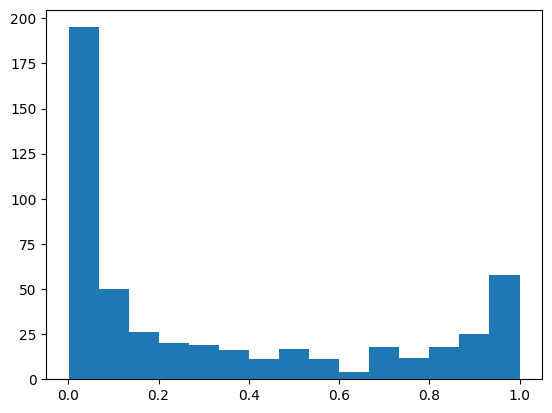

In [ ]:
mem_val = np.array([tr_mp_ix_mem[i] for i in tr_ixs])
plt.hist(mem_val, bins=15)

In [ ]:
start = time.time()
# best_ix, best_val = get_similar_group(X_tr_mix, Y_tr_mix, model, m_aug, ds_train_viz, X_emb_tr, Y_tr, n=k)
best_ix, best_val = get_similar_group(X_tr_mix, Y_tr_mix, model, X_emb_tr_pae, Y_train, n=k, emb_type='prediction')
print(f"Time taken: {np.round(time.time() - start, 4)}s")

16/16 [==============================] - 2s 152ms/step
Time taken: 18.3481s


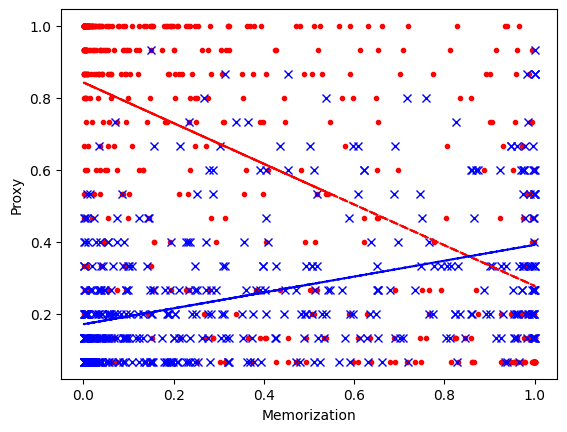

In [ ]:
pct_sameclass_label = np.array([(Y_train.argmax(axis=1)[best_ix[i]]==Y_tr_mix[i].argmax()).mean() for i in range(len(best_ix))])
num_classes_label = np.array([len(np.unique(Y_train.argmax(axis=1)[best_ix[i]])) for i in range(len(best_ix))])
num_classes_label = num_classes_label/k  # normalize
plt.figure()
plt.xlabel('Memorization')
plt.ylabel('Proxy')
plt.plot(mem_val, pct_sameclass_label, 'r.')
plt.plot(mem_val, num_classes_label, 'bx')
# lines of best fit
a1, b1 = np.polyfit(mem_val, pct_sameclass_label, 1)
plt.plot(mem_val, a1*mem_val + b1, 'r--')
a2, b2 = np.polyfit(mem_val, num_classes_label, 1)
plt.plot(mem_val, a2*mem_val + b2, 'b--')

In [ ]:
print(np.corrcoef(mem_val, 1-pct_sameclass_label)[0,1])
print(np.corrcoef(mem_val, num_classes_label)[0,1])

0.5848466471971555
0.40950163230904696


In [ ]:
import scipy.stats as ss
print('Spearman-R')
print(ss.spearmanr(mem_val, 1-pct_sameclass_label))
print(ss.spearmanr(mem_val, num_classes_label))
print('Kendall-Tau')
print(ss.kendalltau(mem_val, 1-pct_sameclass_label))
print(ss.kendalltau(mem_val, num_classes_label))
print('Pearson-R')
print(ss.pearsonr(mem_val, 1-pct_sameclass_label))
print(ss.pearsonr(mem_val, num_classes_label))

Spearman-R
SignificanceResult(statistic=0.5850490179125872, pvalue=2.992924669784565e-47)
SignificanceResult(statistic=0.47519158006482115, pvalue=1.5731326834050752e-29)
Kendall-Tau
SignificanceResult(statistic=0.43170872703810775, pvalue=1.0255237918960733e-42)
SignificanceResult(statistic=0.34384027217932117, pvalue=5.638257782225077e-27)
Pearson-R
PearsonRResult(statistic=0.5848466471971551, pvalue=3.274637531494599e-47)
PearsonRResult(statistic=0.40950163230904685, pvalue=1.2230075659074873e-21)


In [ ]:
# to confirm that ranked correlation methods do appropriate ranking internally
mem_val_r = np.array([sorted(mem_val).index(x) for x in mem_val])
pct_sameclass_label_r = np.array([sorted(pct_sameclass_label).index(x) for x in pct_sameclass_label])
num_classes_label_r = np.array([sorted(num_classes_label).index(x) for x in num_classes_label])

print('Spearman-R')
print(ss.spearmanr(mem_val_r, 1-pct_sameclass_label_r))
print(ss.spearmanr(mem_val_r, num_classes_label_r))
print('Kendall-Tau')
print(ss.kendalltau(mem_val_r, 1-pct_sameclass_label_r))
print(ss.kendalltau(mem_val_r, num_classes_label_r))
print('Pearson-R')
print(ss.pearsonr(mem_val_r, 1-pct_sameclass_label_r))
print(ss.pearsonr(mem_val_r, num_classes_label_r))

Spearman-R
SignificanceResult(statistic=0.5850490179125872, pvalue=2.992924669784565e-47)
SignificanceResult(statistic=0.47519158006482115, pvalue=1.5731326834050752e-29)
Kendall-Tau
SignificanceResult(statistic=0.43170872703810775, pvalue=1.0255237918960733e-42)
SignificanceResult(statistic=0.34384027217932117, pvalue=5.638257782225077e-27)
Pearson-R
PearsonRResult(statistic=0.5932867661457029, pvalue=7.281804087877762e-49)
PearsonRResult(statistic=0.47292107283997126, pvalue=3.1555942379849876e-29)





 75 100
0.5227368542081864 1.0
16/16 [==============================] - 2s 103ms/step
Spearman-R
SignificanceResult(statistic=0.286000593574039, pvalue=7.232672482460296e-11)
SignificanceResult(statistic=0.1085989240973963, pvalue=0.015121458805241458)
Kendall-Tau
SignificanceResult(statistic=0.20090631597026204, pvalue=1.9787189275844632e-10)
SignificanceResult(statistic=0.07574479861504241, pvalue=0.015909351553671926)
Pearson-R
PearsonRResult(statistic=0.25412489946860417, pvalue=8.26030788110413e-09)
PearsonRResult(statistic=0.07516250200052024, pvalue=0.09318059287033224)



 50 75
0.06460635002581311 0.5227368542081864
16/16 [==============================] - 2s 103ms/step
Spearman-R
SignificanceResult(statistic=0.24047827002764754, pvalue=5.213020059101653e-08)
SignificanceResult(statistic=0.2927348602125139, pvalue=2.4527274538232726e-11)
Kendall-Tau
SignificanceResult(statistic=0.16595083172164646, pvalue=1.1050400755396964e-07)
SignificanceResult(statistic=0.20609686041183

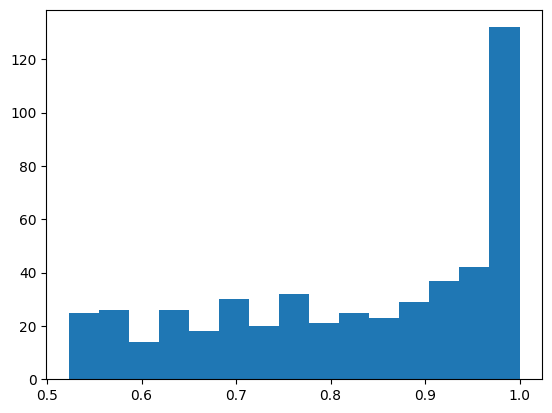

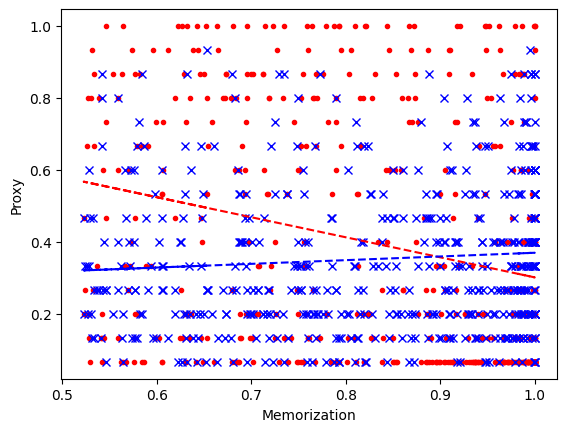

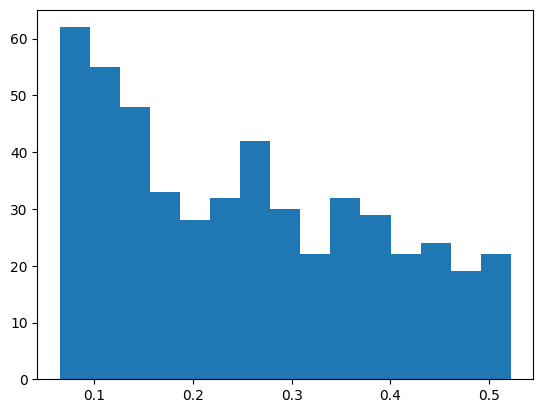

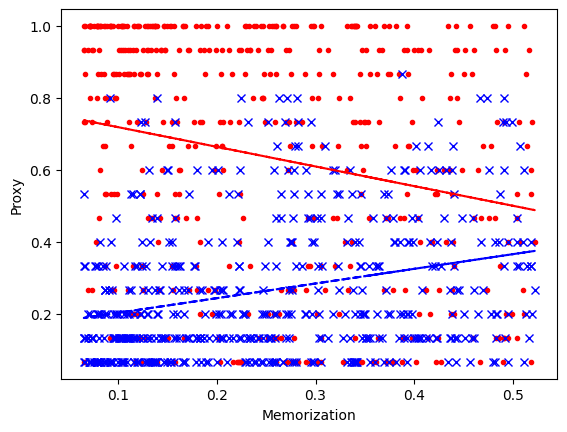

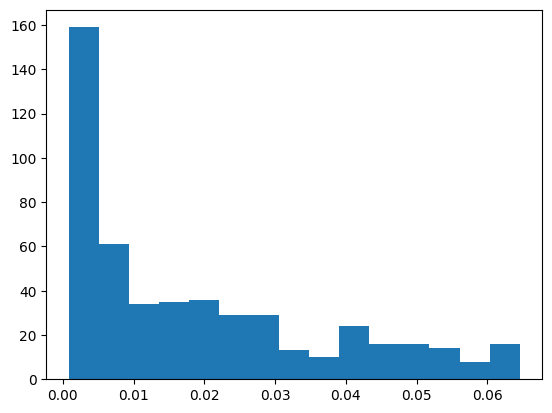

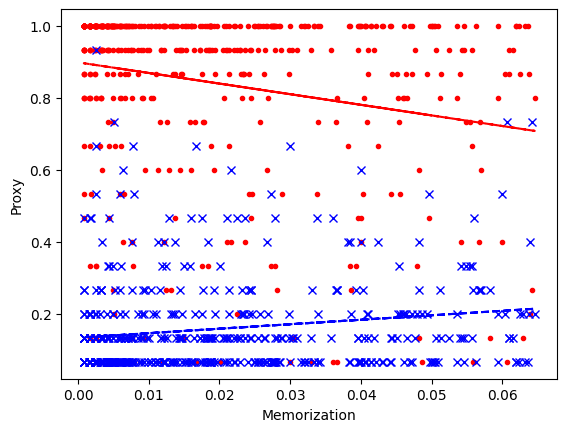

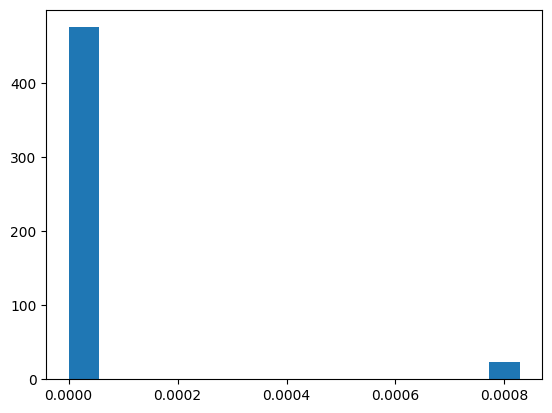

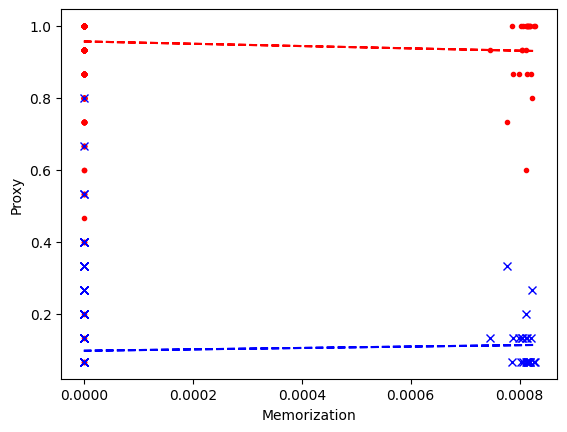

In [ ]:
percentile_group_size = 25
max_percentile_mem = 100
min_percentile_mem = max_percentile_mem - percentile_group_size

for i in range(int(max_percentile_mem/percentile_group_size)):
  print('\n\n\n', min_percentile_mem, max_percentile_mem)
  mem_thresh_low = np.percentile(tr_mem_mp, min_percentile_mem)
  mem_thresh_high = np.percentile(tr_mem_mp, max_percentile_mem)
  print(mem_thresh_low, mem_thresh_high)
  tr_ixs_all = tr_ix_mp_aligned[(tr_mem_mp >= mem_thresh_low) & (tr_mem_mp <= mem_thresh_high)]
  tr_ixs = np.random.choice(tr_ixs_all, size=num_tr, replace=False)
  # tr_ixs = np.sort(tr_ixs_all)[:num_tr]   # temp, to access data faster
  X_tr_mix, Y_tr_mix = X_train[tr_ixs], Y_train[tr_ixs]

  mem_val = np.array([tr_mp_ix_mem[i] for i in tr_ixs])
  plt.figure()
  plt.hist(mem_val, bins=15)

  best_ix, best_val = get_similar_group(X_tr_mix, Y_tr_mix, model, X_emb_tr_pae, Y_train, n=k, emb_type='prediction')
  # best_ix, best_val = get_similar_group(X_tr_mix, Y_tr_mix, model, X_emb_tr_penult, Y_train, n=k, emb_type='penultimate')

  pct_sameclass_label = np.array([(Y_train.argmax(axis=1)[best_ix[i]]==Y_tr_mix[i].argmax()).mean() for i in range(len(best_ix))])
  num_classes_label = np.array([len(np.unique(Y_train.argmax(axis=1)[best_ix[i]])) for i in range(len(best_ix))])
  num_classes_label = num_classes_label/k  # normalize
  plt.figure()
  plt.xlabel('Memorization')
  plt.ylabel('Proxy')
  plt.plot(mem_val, pct_sameclass_label, 'r.')
  plt.plot(mem_val, num_classes_label, 'bx')
  # lines of best fit
  a1, b1 = np.polyfit(mem_val, pct_sameclass_label, 1)
  plt.plot(mem_val, a1*mem_val + b1, 'r--')
  a2, b2 = np.polyfit(mem_val, num_classes_label, 1)
  plt.plot(mem_val, a2*mem_val + b2, 'b--')

  # print(np.corrcoef(mem_val, 1-pct_sameclass_label)[0,1])
  # print(np.corrcoef(mem_val, num_classes_label)[0,1])
  print('Spearman-R')
  print(ss.spearmanr(mem_val, 1-pct_sameclass_label))
  print(ss.spearmanr(mem_val, num_classes_label))
  print('Kendall-Tau')
  print(ss.kendalltau(mem_val, 1-pct_sameclass_label))
  print(ss.kendalltau(mem_val, num_classes_label))
  print('Pearson-R')
  print(ss.pearsonr(mem_val, 1-pct_sameclass_label))
  print(ss.pearsonr(mem_val, num_classes_label))

  max_percentile_mem -= percentile_group_size
  min_percentile_mem -= percentile_group_size